In [43]:
import numpy as np
import pandas as pd
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
import pyMechkar as mechkar
import pyTable1 as tbl1
import datetime as dt
from scipy.stats import kurtosis,skew
from scipy.stats import normaltest
from scipy.stats import anderson

In [44]:
desired_width = 620
pd.set_option('display.width', desired_width)
pd.set_option('display.max_columns',200)
np.set_printoptions(linewidth = desired_width)

In [45]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

In [46]:
def make_one_hot(data,col_name):
    new_col_names = list(data[col_name].unique())
    ncat = len(new_col_names)-1
    for i in range(0,ncat):
        data[new_col_names[i]] = None
        data.loc[(data[col_name] == new_col_names[i]),new_col_names[i]] = 1
        data.loc[(data[col_name] != new_col_names[i]),new_col_names[i]] = 0 

# Data Collection

## Read FlatFile csv

In [47]:
FF = pd.read_csv("D:\\EndProject\\FlatFile.csv",header=0)
FF['visit_date'] =  pd.to_datetime(FF['visit_date'], format = '%Y-%m-%d')
FF.head()

,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover
0,ir_04341b588bde96cd,Izakaya,Tokyo-to Nerima-ku Toyotamakita,35.735623,139.651658,2016-01-01,10,NaN,510,Friday,1,tokyo__nerima-kana__nerima,35.738333,139.591667,5.435240,5.424557,6.9,11.8,2.1,0.0,9.1,NaN,NaN,NaN,1.8,NaN,NaN,NaN,NaN,NaN
1,ir_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-01,29,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,7.3,12.6,3.1,NaN,6.6,10.35,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3
2,ir_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,11,NaN,510,Friday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,2.4,6.1,-1.5,0.0,3.7,5.71,NaN,NaN,2.8,4.6,1019.1,64.0,1024.7,4.0
3,ir_09a845d5b5944b01,Izakaya,Fukuoka-ken Kurume-shi Jonanmachi,33.319286,130.508374,2016-01-01,56,NaN,510,Friday,1,fukuoka__kurume-kana__kurume,33.303333,130.493333,2.256617,2.258974,5.9,11.1,1.9,0.0,7.3,NaN,NaN,NaN,1.2,NaN,NaN,NaN,NaN,NaN
4,ir_1f7f8fa557bc0d55,Bar/Cocktail,Osaka-fu Neyagawa-shi Honmachi,34.766093,135.628100,2016-01-01,6,NaN,510,Friday,1,Osaka__hirakata-kana__hirakata,34.808333,135.671667,6.152897,6.157249,5.5,11.9,1.0,0.0,6.0,NaN,NaN,NaN,0.8,NaN,NaN,NaN,NaN,NaN


## Adding external data

In [6]:
CPI = pd.read_csv("D:\\EndProject\\Consumer Price Index of All Items in Japan.csv",header=0)
WAP = pd.read_csv("D:\\EndProject\\Working Age Population Aged 15-64 All Persons.csv",header=0)
CPIO = pd.read_csv("D:\\EndProject\\Consumer Price Index OECD Groups All Items Non-Food and Non-Energy.csv",header=0)
UR = pd.read_csv("D:\\EndProject\\Unemployment Rate Aged 15-64 All Persons.csv",header=0)
FER = pd.read_csv("D:\\EndProject\\Japan  U.S. Foreign Exchange Rate.csv",header=0)
N225 = pd.read_csv("D:\\EndProject\\Nikkei Stock Average, Nikkei 225.csv",header=0)


In [11]:
#CPI
#WAP
#CPIO
#UR
#FER
N225.dtypes

DATE         object
NIKKEI225    object
dtype: object

# Exploratory Data Analysis

In [7]:
## use describe() to get the descriptive statistics
# this is data exploration.  if the mean and 50% are similar it might be a normal variable 
FF.describe()

,latitude,longitude,visitors,reservations,daily_reservations,holiday_flg,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover
count,252108.000000,252108.000000,252108.000000,28064.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,252108.000000,227486.000000,227482.000000,227482.000000,175718.000000,216662.000000,169373.000000,9565.000000,5320.000000,227377.000000,186636.000000,186870.000000,186636.000000,186870.000000,177616.000000
mean,35.613121,137.357865,20.973761,13.751283,24727.685353,0.050673,35.614647,137.357938,3.821379,3.821444,14.764283,19.125582,11.063648,6.095662,5.324347,12.720834,34.032933,4.765789,2.841797,13.408370,1010.738995,67.392684,1014.810193,6.893899
std,2.044473,3.671577,16.757007,17.284799,20463.131251,0.219329,2.044327,3.671401,2.197806,2.197646,8.625659,8.802811,8.973240,14.428468,3.941580,6.908376,30.811071,6.388326,1.130449,8.721466,7.769830,14.935167,7.265501,3.068532
min,33.211967,130.195555,1.000000,1.000000,510.000000,0.000000,33.225000,130.190000,0.416011,0.415906,-18.800000,-10.600000,-29.100000,0.000000,0.000000,0.480000,0.000000,0.000000,0.300000,1.400000,975.700000,24.000000,985.800000,0.000000
25%,34.692337,135.341564,9.000000,5.000000,12017.000000,0.000000,34.681667,135.335000,1.939005,1.936238,7.700000,12.100000,3.600000,0.000000,1.400000,7.160000,1.000000,1.000000,2.100000,6.000000,1005.700000,56.000000,1009.900000,4.800000
50%,35.658068,139.670038,17.000000,10.000000,18713.000000,0.000000,35.691667,139.620000,3.573166,3.572811,13.600000,18.300000,9.150000,0.000000,5.400000,11.840000,33.000000,3.000000,2.700000,10.100000,1011.000000,67.000000,1015.300000,7.500000
75%,35.694003,139.751599,29.000000,18.000000,29228.000000,0.000000,35.691667,139.750000,5.319959,5.318636,22.600000,26.500000,20.000000,5.500000,8.800000,17.610000,63.000000,6.000000,3.400000,21.300000,1016.100000,79.000000,1019.800000,9.800000
max,44.020632,144.273398,877.000000,1633.000000,167953.000000,1.000000,44.016667,144.278333,12.217263,12.189999,32.400000,38.300000,28.900000,208.000000,14.800000,31.320000,96.000000,44.000000,12.800000,32.700000,1031.600000,100.000000,1036.200000,10.000000


In [8]:
FF.dtypes

air_store_id                  object
air_genre_name                object
air_area_name                 object
latitude                     float64
longitude                    float64
visit_date            datetime64[ns]
visitors                       int64
reservations                 float64
daily_reservations             int64
dow                           object
holiday_flg                    int64
station_id                    object
st_lat                       float64
st_long                      float64
st_vincenty                  float64
st_great_circle              float64
avg_temperature              float64
high_temperature             float64
low_temperature              float64
precipitation                float64
hours_sunlight               float64
solar_radiation              float64
deepest_snowfall             float64
total_snowfall               float64
avg_wind_speed               float64
avg_vapor_pressure           float64
avg_local_pressure           float64
a

In [9]:
tbl1 = mechkar.pyMechkar().Table1(data=FF)

Factorizing... please wait
[******************************
['The variable air_store_id is not well defined. This data type is not allowed in Table1... avoided', 'The variable air_genre_name is not well defined. This data type is not allowed in Table1... avoided', 'The variable air_area_name is not well defined. This data type is not allowed in Table1... avoided', 'The variable visit_date is a date. Dates are not allowed in Table1... avoided', 'The variable dow is not well defined. This data type is not allowed in Table1... avoided', 'The variable station_id is not well defined. This data type is not allowed in Table1... avoided']
------ Finished in 7.499729871749878econds -----


In [10]:
pd.set_option('display.max_rows',100)
tbl1

,Del,Variables,Categories,n,Population
0,0,Individuals,n,1,252108
1,0,latitude,Mean (SD),1,35.60 ( 2.00)
2,0,latitude,Median (IQR),2,35.70 ( 34.70- 35.70)
3,1,latitude,Missing (%),3,--
4,0,longitude,Mean (SD),1,137.40 ( 3.70)
5,0,longitude,Median (IQR),2,139.70 ( 135.30- 139.80)
6,1,longitude,Missing (%),3,--
7,0,visitors,Mean (SD),1,21.00 ( 16.80)
8,0,visitors,Median (IQR),2,17.00 ( 9.00- 29.00)
9,1,visitors,Missing (%),3,--


### We can see that some fields have large precentages of missings<br/>So the weather fields with high precentage of missing ('deepest_snowfall' 96% and 'total_snowfall' 97%)<br/>Cannot be used, so will be removed!<br/>The reservations field that have 88% of missing, but is too importent to be ignored.<br/>So..  we will divide the data to two Falt Files:<br/>One that contains only records with reservations data and another that contains all the records but without the fields of reseervations data.

In [16]:
# reservations - Missing - 224,044.00 ( 88.90%)
# avg_temperature - Missing - 24,622.00 ( 9.80%)
# high_temperature - Missing - 24,626.00 ( 9.80%)
# low_temperature - Missing - 24,626.00 ( 9.80%)
# precipitation - Missing - 76,390.00 ( 30.30%)
# hours_sunlight - Missing - 35,446.00 ( 14.10%)
# solar_radiation - Missing - 82,735.00 ( 32.80%)
# deepest_snowfall - Missing - 242,543.00 ( 96.20%)
# total_snowfall - Missing - 246,788.00 ( 97.90%)
# avg_wind_speed - Missing - 24,731.00 ( 9.80%)
# avg_vapor_pressure - Missing - 65,472.00 ( 26.00%)
# avg_local_pressure - Missing - 65,238.00 ( 25.90%)
# avg_humidity - Missing - 65,472.00 ( 26.00%)
# avg_sea_pressure - Missing - 65,238.00 ( 25.90%)
# cloud_cover - Missing - 74,492.00 ( 29.50%)
#list(FF)

In [48]:
Ordinal_Fields = ['latitude','longitude','visit_date','visitors','reservations','daily_reservations','st_vincenty','st_great_circle','avg_temperature','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','deepest_snowfall','total_snowfall','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\histograms.py:754: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\histograms.py:755: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


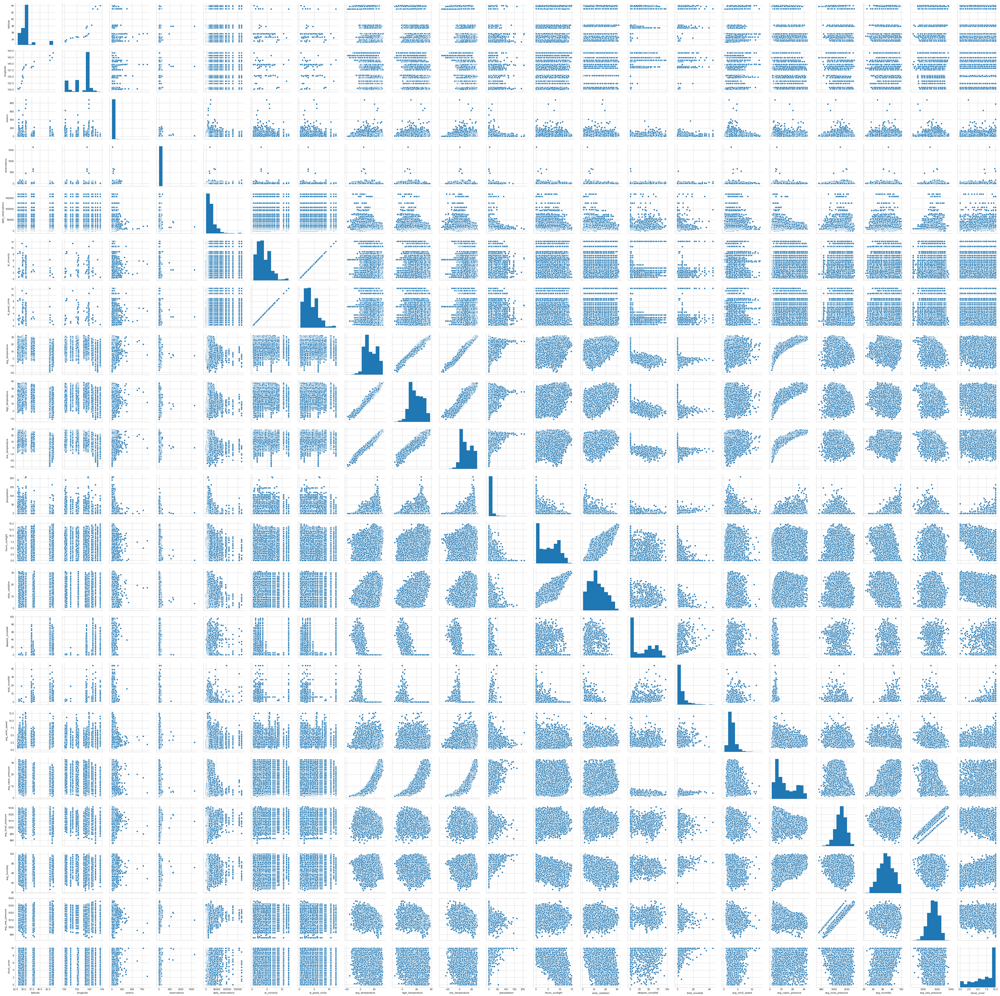

In [18]:
sns.pairplot(FF[Ordinal_Fields])

### Removing two high missing weather fields: <br/>deepest_snowfall - 96%<br/>total_snowfall - 97%

In [49]:
FF_Backup = FF.copy()
del FF['deepest_snowfall']
del FF['total_snowfall']

In [38]:
#FF_Backup

## Creating two flatfiles!

In [50]:
FF_NR = FF.copy()
del FF_NR['reservations']

In [73]:
#FF_OR = FF.loc[(FF['visit_date'] >= '2016-10-27') & (FF['reservations'] != 0)]
FF_OR = FF.loc[FF['reservations'].notnull()]

# Outliers Detection and Treatment

## Univariet outlier detection

In [52]:
def zscore_outliers(x, cutoff=3.0, return_thresholds=False):
    """
    Return a boolean mask of outliers for a series
    using standard deviation, works column-wise.
    param nstd:
        Set number of standard deviations from the mean
        to consider an outlier
    :type nstd: ``float``
    param return_thresholds:
        True returns the lower and upper bounds, good for plotting.
        False returns the masked array 
    :type return_thresholds: ``bool``
    """
    dmean = x.mean()
    dsd = x.std()
    rng = dsd * cutoff
    lower = dmean - rng
    upper = dmean + rng
    if return_thresholds:
        return lower, upper
    else:
        return [True if z < lower or z > upper else False for z in x]


def iqr_outliers(x, k=1.5, return_thresholds=False):
    """
    Return a boolean mask of outliers for a series
    using interquartile range, works column-wise.
    param k:
        some cutoff to multiply by the iqr
    :type k: ``float``
    param return_thresholds:
        True returns the lower and upper bounds, good for plotting.
        False returns the masked array 
    :type return_thresholds: ``bool``
    """
    # calculate interquartile range
    q25 = np.percentile(x, 25)
    q75 = np.percentile(x, 75)
    iqr = q75 - q25
    # calculate the outlier cutoff
    cut_off = iqr * k
    lower, upper = q25 - cut_off, q75 + cut_off
    if return_thresholds:
        return lower, upper
    else: # identify outliers
        return [True if z < lower or z > upper else False for z in x]

In [53]:
def Automatic_Normality_Test(Ordinal_Fields):
    for C in Ordinal_Fields:
        n = 0
        # normality test
        stat, p = normaltest(FF_OR[C])
        print('Normaltest Statistics=%.3f, p=%.3f' % (stat, p))
        result = anderson(FF_OR[C])
        print('Anderson Statistic: %.3f' % result.statistic)
        # interpret
        alpha = 0.05
        for i in range(len(result.critical_values)):
            sl, cv = result.significance_level[i], result.critical_values[i]
            if result.statistic < result.critical_values[i]:
                #print('%.3f: %.3f, data looks normal (fail to reject H0)' % (sl, cv))
                n = n + 1
            else:
                #print('%.3f: %.3f, data does not look normal (reject H0)' % (sl, cv))
                n = n - 1

        if p > alpha:
            #print('Sample looks Gaussian (fail to reject H0)')
            n = n + 1
        else:
            #print('Sample does not look Gaussian (reject H0)')
            n = n - 1


        if n <= 0:
            print(n,'/6 tests came negative, data does not look normal')
            print("Number of outliers for ", i , " is: " , np.sum(iqr_outliers(FF_OR[C],k=1.5,return_thresholds=False)))
            out = np.sum(iqr_outliers(FF_OR[C],k=1.5,return_thresholds=False))
            if out > 0:
                iqr=iqr_outliers(FF_OR[C],k=1.5,return_thresholds=False)
                plt.figure(C)
                sns.scatterplot(x=FF_OR[C],y=FF_OR['air_store_id'],hue=iqr)
        else:
            print(n,'/6 tests came positive, data looks normal')
            print("Number of outliers for ", i , " is: " , np.sum(zscore_outliers(FF_OR[C], cutoff=1.5, return_thresholds=False)))
            out = np.sum(zscore_outliers(FF_OR[C], cutoff=1.5, return_thresholds=False))
            if out > 0:
                z=zscore_outliers(FF_OR[C], cutoff=1.5, return_thresholds=False)
                plt.figure(C)
                sns.scatterplot(x=FF_OR[C],y=FF_OR['air_store_id'],hue=z)


## Univariant outliers detection

## visual test

### According to the pairplot observations, we made outliers tests<br/><br/>We found that the fields: 'avg_local_pressure', 'avg_humidity', 'avg_sea_pressure'

In [61]:
print("Number of outliers according to Z_score for average local pressure is: " , np.sum(zscore_outliers(FF_NR['avg_local_pressure'], cutoff=1.5, return_thresholds=False)))
print("Number of outliers according to Z_score for average humidity is: " , np.sum(zscore_outliers(FF_NR['avg_humidity'], cutoff=1.5, return_thresholds=False)))
print("Number of outliers according to Z_score for average sea pressure is: " , np.sum(zscore_outliers(FF_NR['avg_sea_pressure'], cutoff=1.25, return_thresholds=False)))

print("Number of outliers according to IRQ for visitors is: " , np.sum(iqr_outliers(FF_NR['visitors'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average temperature is: " , np.sum(iqr_outliers(FF_NR['avg_temperature'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for maximum temperature is: " , np.sum(iqr_outliers(FF_NR['high_temperature'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for minimum temperature is: " , np.sum(iqr_outliers(FF_NR['low_temperature'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for precipitation is: " , np.sum(iqr_outliers(FF_NR['precipitation'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for hours of sunlight is: " , np.sum(iqr_outliers(FF_NR['hours_sunlight'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for solar radiation is: " , np.sum(iqr_outliers(FF_NR['solar_radiation'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average wind speed is: " , np.sum(iqr_outliers(FF_NR['avg_wind_speed'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average vapor pressure is: " , np.sum(iqr_outliers(FF_NR['avg_vapor_pressure'],k=1.25,return_thresholds=False)))
print("Number of outlier according to IRQs for cloud cover is: " , np.sum(iqr_outliers(FF_NR['cloud_cover'],k=1.25,return_thresholds=False)))

Number of outliers according to Z_score for average local pressure is:  24145
Number of outliers according to Z_score for average humidity is:  24603
Number of outliers according to Z_score for average sea pressure is:  43116
Number of outliers according to IRQ for visitors is:  10331
Number of outliers according to IRQ for average temperature is:  0
Number of outliers according to IRQ for maximum temperature is:  0
Number of outliers according to IRQ for minimum temperature is:  0


c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\function_base.py:3652: RuntimeWarning: Invalid value encountered in percentile
  interpolation=interpolation)


Number of outliers according to IRQ for precipitation is:  0
Number of outliers according to IRQ for hours of sunlight is:  0
Number of outliers according to IRQ for solar radiation is:  0
Number of outliers according to IRQ for average wind speed is:  0
Number of outliers according to IRQ for average vapor pressure is:  0
Number of outlier according to IRQs for cloud cover is:  0


Number of outliers according to Z_score for average local pressure is:  24145


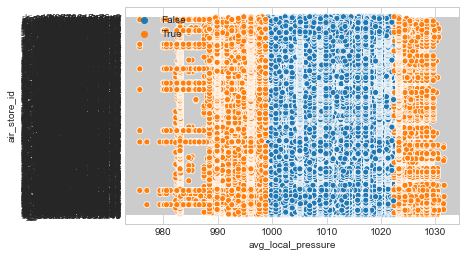

In [122]:
out1=zscore_outliers(FF_NR['avg_local_pressure'], cutoff=1.5, return_thresholds=False)
sns.scatterplot(x=FF_NR['avg_local_pressure'],y=FF_NR['air_store_id'],hue=out1)
print("Number of outliers according to Z_score for average local pressure is: " , np.sum(zscore_outliers(FF_NR['avg_local_pressure'], cutoff=1.5, return_thresholds=False)))

In [70]:
len(FF_OR)

252108

Number of outliers according to Z_score for average humidity is:  24603


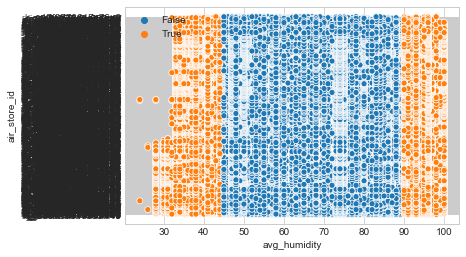

In [123]:
out2=zscore_outliers(FF_NR['avg_humidity'], cutoff=1.5, return_thresholds=False)
sns.scatterplot(x=FF_NR['avg_humidity'],y=FF_NR['air_store_id'],hue=out2)
print("Number of outliers according to Z_score for average humidity is: " , np.sum(zscore_outliers(FF_NR['avg_humidity'], cutoff=1.5, return_thresholds=False)))

Number of outliers according to Z_score for average sea pressure is:  24415


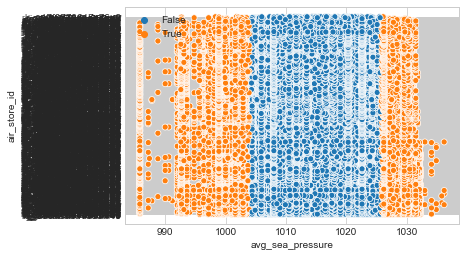

In [124]:
out3=zscore_outliers(FF_NR['avg_sea_pressure'], cutoff=1.5, return_thresholds=False)
sns.scatterplot(x=FF_NR['avg_sea_pressure'],y=FF_NR['air_store_id'],hue=out3)
print("Number of outliers according to Z_score for average sea pressure is: " , np.sum(zscore_outliers(FF_NR['avg_sea_pressure'], cutoff=1.5, return_thresholds=False)))

Number of outliers according to IRQ for visitors is:  6959


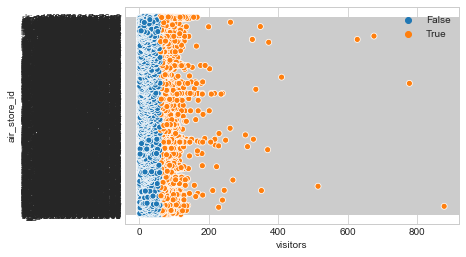

In [130]:
outNR_visitors=iqr_outliers(FF_NR['visitors'],k=1.5,return_thresholds=False)
sns.scatterplot(x=FF_NR['visitors'],y=FF_NR['air_store_id'],hue=outNR_visitors)
print("Number of outliers according to IRQ for visitors is: " , np.sum(iqr_outliers(FF_NR['visitors'],k=1.5,return_thresholds=False)))

In [75]:
print("Number of outliers according to Z_score for average local pressure is: " , np.sum(zscore_outliers(FF_OR['avg_local_pressure'], cutoff=1.5, return_thresholds=False)))
print("Number of outliers according to Z_score for average humidity is: " , np.sum(zscore_outliers(FF_OR['avg_humidity'], cutoff=1.5, return_thresholds=False)))
print("Number of outliers according to Z_score for average sea pressure is: " , np.sum(zscore_outliers(FF_OR['avg_sea_pressure'], cutoff=1.25, return_thresholds=False)))

print("Number of outliers according to IRQ for visitors is: " , np.sum(iqr_outliers(FF_OR['visitors'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for reservations is: " , np.sum(iqr_outliers(FF_OR['reservations'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average temperature is: " , np.sum(iqr_outliers(FF_OR['avg_temperature'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for maximum temperature is: " , np.sum(iqr_outliers(FF_OR['high_temperature'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for minimum temperature is: " , np.sum(iqr_outliers(FF_OR['low_temperature'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for precipitation is: " , np.sum(iqr_outliers(FF_OR['precipitation'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for hours of sunlight is: " , np.sum(iqr_outliers(FF_OR['hours_sunlight'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for solar radiation is: " , np.sum(iqr_outliers(FF_OR['solar_radiation'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average wind speed is: " , np.sum(iqr_outliers(FF_OR['avg_wind_speed'],k=1.25,return_thresholds=False)))
print("Number of outliers according to IRQ for average vapor pressure is: " , np.sum(iqr_outliers(FF_OR['avg_vapor_pressure'],k=1.25,return_thresholds=False)))
print("Number of outlier according to IRQs for cloud cover is: " , np.sum(iqr_outliers(FF_OR['cloud_cover'],k=1.25,return_thresholds=False)))

Number of outliers according to Z_score for average local pressure is:  2715
Number of outliers according to Z_score for average humidity is:  3170
Number of outliers according to Z_score for average sea pressure is:  4772
Number of outliers according to IRQ for visitors is:  1060
Number of outliers according to IRQ for reservations is:  2036
Number of outliers according to IRQ for average temperature is:  0
Number of outliers according to IRQ for maximum temperature is:  0
Number of outliers according to IRQ for minimum temperature is:  0
Number of outliers according to IRQ for precipitation is:  0
Number of outliers according to IRQ for hours of sunlight is:  0
Number of outliers according to IRQ for solar radiation is:  0
Number of outliers according to IRQ for average wind speed is:  0
Number of outliers according to IRQ for average vapor pressure is:  0
Number of outlier according to IRQs for cloud cover is:  0


Number of outliers according to Z_score for average local pressure is:  2715


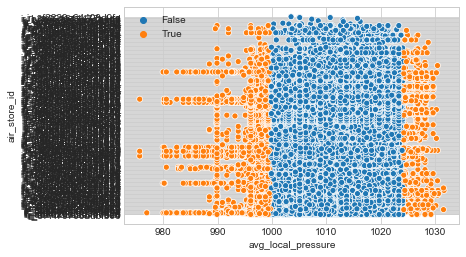

In [126]:
out11=zscore_outliers(FF_OR['avg_local_pressure'], cutoff=1.5, return_thresholds=False)
sns.scatterplot(x=FF_OR['avg_local_pressure'],y=FF_OR['air_store_id'],hue=out11)
print("Number of outliers according to Z_score for average local pressure is: " , np.sum(zscore_outliers(FF_OR['avg_local_pressure'], cutoff=1.5, return_thresholds=False)))

Number of outliers according to Z_score for average humidity is:  3170


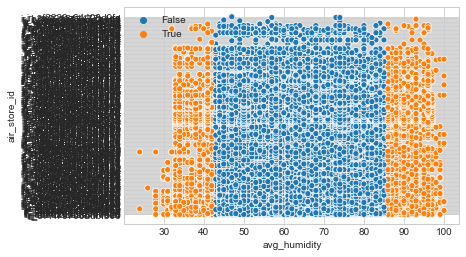

In [127]:
out12=zscore_outliers(FF_OR['avg_humidity'], cutoff=1.5, return_thresholds=False)
sns.scatterplot(x=FF_OR['avg_humidity'],y=FF_OR['air_store_id'],hue=out12)
print("Number of outliers according to Z_score for average humidity is: " , np.sum(zscore_outliers(FF_OR['avg_humidity'], cutoff=1.5, return_thresholds=False)))

Number of outliers according to Z_score for average sea pressure is:  2918


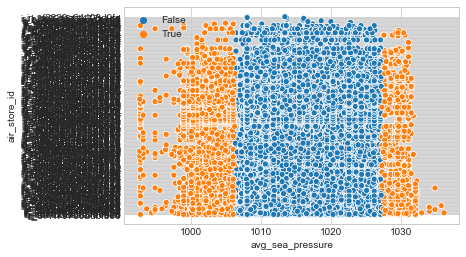

In [128]:
out13=zscore_outliers(FF_OR['avg_sea_pressure'], cutoff=1.5, return_thresholds=False)
sns.scatterplot(x=FF_OR['avg_sea_pressure'],y=FF_OR['air_store_id'],hue=out13)
print("Number of outliers according to Z_score for average sea pressure is: " , np.sum(zscore_outliers(FF_OR['avg_sea_pressure'], cutoff=1.5, return_thresholds=False)))

Number of outliers according to IRQ for visitors is:  673


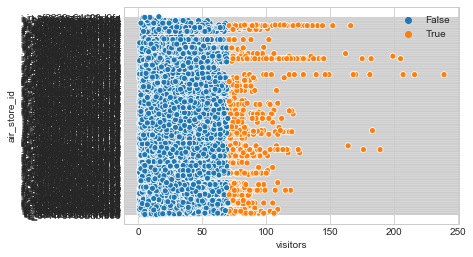

In [131]:
outOR_visitors=iqr_outliers(FF_OR['visitors'],k=1.5,return_thresholds=False)
sns.scatterplot(x=FF_OR['visitors'],y=FF_OR['air_store_id'],hue=outOR_visitors)
print("Number of outliers according to IRQ for visitors is: " , np.sum(iqr_outliers(FF_OR['visitors'],k=1.5,return_thresholds=False)))

## Statistical Tests

In [16]:
# creating a vector of ordinal values for univariant outlier detection (FF_OR)
FF_OR_Ordinal_Fields = ['visitors','reservations','daily_reservations','st_vincenty','st_great_circle','avg_temperature','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']

# creating a vector of ordinal values for univariant outlier detection (FF_NR)
FF_NR_Ordinal_Fields = ['visitors','daily_reservations','st_vincenty','st_great_circle','avg_temperature','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']

In [ ]:
Automatic_Normality_Test()

## Multivariate Test

In [54]:
def dbscan_mvoutliers(X):
    from sklearn.cluster import DBSCAN
    from sklearn.preprocessing import StandardScaler
    # scale data first
    X = StandardScaler().fit_transform(X.values)

    db = DBSCAN(eps=3.0, min_samples=10).fit(X)
    labels = db.labels_

    plt.figure(figsize=(10,10))

    unique_labels = set(labels)
    colors = ['blue', 'red']

    for color,label in zip(colors, unique_labels):
        sample_mask = [True if l == label else False for l in labels]
        plt.plot(X[:,0][sample_mask], X[:, 1][sample_mask], 'o', color=color);
    plt.xlabel('x');
    plt.ylabel('y');

    return(db)

#### Running dbscan on no reservations faltfile model

In [83]:
#'visitors',
V = ['visitors','st_vincenty','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']
print(FF_NR[V].isna().sum())
FF_NR_NA = FF_NR.copy()

visitors                  0
st_vincenty               0
high_temperature      24626
low_temperature       24626
precipitation         76390
hours_sunlight        35446
solar_radiation       82735
avg_wind_speed        24731
avg_vapor_pressure    65472
avg_local_pressure    65238
avg_humidity          65472
avg_sea_pressure      65238
cloud_cover           74492
dtype: int64


In [90]:
FF_NR_NA = FF_NR_NA.loc[FF_NR_NA['precipitation'].notnull()]
FF_NR_NA = FF_NR_NA.loc[FF_NR_NA['solar_radiation'].notnull()]
FF_NR_NA = FF_NR_NA.loc[FF_NR_NA['avg_humidity'].notnull()]
FF_NR_NA = FF_NR_NA.loc[FF_NR_NA['avg_wind_speed'].notnull()]

In [91]:
print(FF_NR_NA[V].isna().sum())
FF_NR_NA

visitors              0
st_vincenty           0
high_temperature      0
low_temperature       0
precipitation         0
hours_sunlight        0
solar_radiation       0
avg_wind_speed        0
avg_vapor_pressure    0
avg_local_pressure    0
avg_humidity          0
avg_sea_pressure      0
cloud_cover           0
dtype: int64


,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover
2,ir_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,11,510,Friday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,2.4,6.1,-1.5,0.0,3.7,5.71,2.8,4.6,1019.1,64.0,1024.7,4.0
13,ir_536043fcf1a4f8a4,Bar/Cocktail,Osaka-fu Osaka-shi Kyūtaromachi,34.681261,135.509801,2016-01-01,42,510,Friday,1,Osaka__osaka-kana__osaka,34.681667,135.518333,0.783208,0.781715,7.6,11.4,4.4,0.0,9.0,11.94,1.6,6.1,1019.4,59.0,1029.7,1.0
20,ir_71903025d39a4571,Cafe/Sweets,Hokkaido Sapporo-shi Minami 3 Jonishi,43.055460,141.340956,2016-01-01,5,510,Friday,1,hokkaido_ishikari__sapporo-katakana__satporo,43.060000,141.328333,1.145298,1.143351,-1.1,0.2,-2.6,1.0,2.0,4.46,3.5,3.3,1017.8,59.0,1021.2,9.3
23,ir_81c5dff692063446,Dining bar,Osaka-fu Osaka-shi Ogimachi,34.705362,135.510025,2016-01-01,7,510,Friday,1,Osaka__osaka-kana__osaka,34.681667,135.518333,2.736619,2.742844,7.6,11.4,4.4,0.0,9.0,11.94,1.6,6.1,1019.4,59.0,1029.7,1.0
29,ir_a083834e7ffe187e,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,27,510,Friday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,2.4,6.1,-1.5,0.0,3.7,5.71,2.8,4.6,1019.1,64.0,1024.7,4.0
39,ir_db4b38ebe7a7ceff,Dining bar,Osaka-fu Osaka-shi Shinmachi,34.676231,135.486059,2016-01-01,21,510,Friday,1,Osaka__osaka-kana__osaka,34.681667,135.518333,3.018594,3.013344,7.6,11.4,4.4,0.0,9.0,11.94,1.6,6.1,1019.4,59.0,1029.7,1.0
40,ir_db80363d35f10926,Dining bar,Hokkaido Asahikawa-shi 6 Jodori,43.770635,142.364819,2016-01-01,8,510,Friday,1,hokkaido_kamikawa__asahikawa-kana__asahikawa,43.756667,142.371667,1.647083,1.648196,-3.9,-1.8,-4.9,1.5,1.8,5.35,3.0,3.8,1003.0,82.0,1020.9,8.8
45,ir_f690c42545146e0a,Japanese food,Hokkaido Sapporo-shi Minami 3 Jonishi,43.056819,141.353957,2016-01-01,7,510,Friday,1,hokkaido_ishikari__sapporo-katakana__satporo,43.060000,141.328333,2.117131,2.112266,-1.1,0.2,-2.6,1.0,2.0,4.46,3.5,3.3,1017.8,59.0,1021.2,9.3
48,ir_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-02,21,3217,Saturday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,11.6,14.7,8.3,0.0,0.6,5.00,2.2,9.4,1023.0,69.0,1024.8,10.0
49,ir_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-02,23,3217,Saturday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,6.2,10.4,-0.1,0.0,0.8,3.28,3.0,6.1,1013.5,64.0,1018.9,6.3


#### Before we use dbscan to searche for outliers, we need to normalize the data.

In [104]:
FF_NR_Norm = (FF_NR_NA[V] - FF_NR_NA[V].mean()) / (FF_NR_NA[V].max() - FF_NR_NA[V].min())

DBSCAN(algorithm='auto', eps=3.0, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=10, n_jobs=None, p=None)

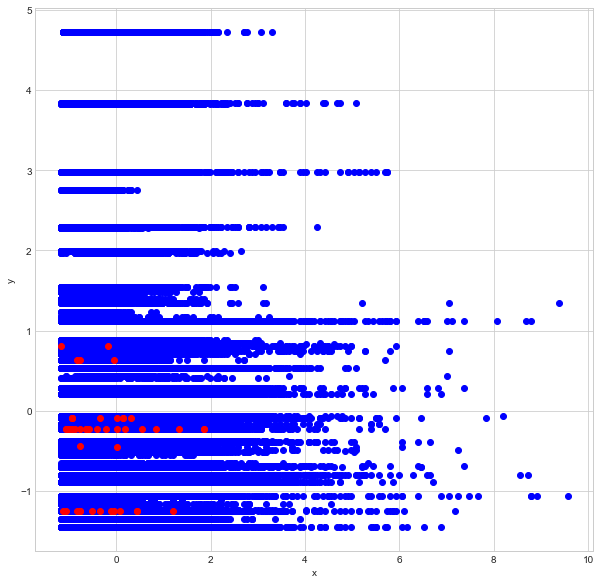

In [105]:
dbscan_temp_result = dbscan_mvoutliers(FF_NR_Norm)

#### Running dbscan on reservations only flatfile model

In [93]:
#'visitors',
V_O = ['visitors','reservations','st_vincenty','high_temperature',
                  'low_temperature','precipitation','hours_sunlight','solar_radiation','avg_wind_speed','avg_vapor_pressure','avg_local_pressure',
                  'avg_humidity','avg_sea_pressure','cloud_cover']
print(FF_OR[V_O].isna().sum())
FF_OR_NA = FF_OR.copy()

visitors                 0
reservations             0
st_vincenty              0
high_temperature      1301
low_temperature       1301
precipitation         9205
hours_sunlight        3003
solar_radiation       8222
avg_wind_speed        1325
avg_vapor_pressure    5267
avg_local_pressure    5225
avg_humidity          5267
avg_sea_pressure      5225
cloud_cover           7450
dtype: int64


In [100]:
FF_OR_NA = FF_OR_NA.loc[FF_OR_NA['precipitation'].notnull()]
FF_OR_NA = FF_OR_NA.loc[FF_OR_NA['solar_radiation'].notnull()]
FF_OR_NA = FF_OR_NA.loc[FF_OR_NA['avg_humidity'].notnull()]
FF_OR_NA = FF_OR_NA.loc[FF_OR_NA['avg_wind_speed'].notnull()]

In [101]:
print(FF_OR_NA[V_O].isna().sum())
FF_OR_NA

visitors              0
reservations          0
st_vincenty           0
high_temperature      0
low_temperature       0
precipitation         0
hours_sunlight        0
solar_radiation       0
avg_wind_speed        0
avg_vapor_pressure    0
avg_local_pressure    0
avg_humidity          0
avg_sea_pressure      0
cloud_cover           0
dtype: int64


,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover
39,ir_db4b38ebe7a7ceff,Dining bar,Osaka-fu Osaka-shi Shinmachi,34.676231,135.486059,2016-01-01,21,9.0,510,Friday,1,Osaka__osaka-kana__osaka,34.681667,135.518333,3.018594,3.013344,7.6,11.4,4.4,0.0,9.0,11.94,1.6,6.1,1019.4,59.0,1029.7,1.0
40,ir_db80363d35f10926,Dining bar,Hokkaido Asahikawa-shi 6 Jodori,43.770635,142.364819,2016-01-01,8,5.0,510,Friday,1,hokkaido_kamikawa__asahikawa-kana__asahikawa,43.756667,142.371667,1.647083,1.648196,-3.9,-1.8,-4.9,1.5,1.8,5.35,3.0,3.8,1003.0,82.0,1020.9,8.8
67,ir_3bb99a1fe0583897,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-02,39,4.0,3217,Saturday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,6.2,10.4,-0.1,0.0,0.8,3.28,3.0,6.1,1013.5,64.0,1018.9,6.3
101,ir_db80363d35f10926,Dining bar,Hokkaido Asahikawa-shi 6 Jodori,43.770635,142.364819,2016-01-02,94,34.0,3217,Saturday,1,hokkaido_kamikawa__asahikawa-kana__asahikawa,43.756667,142.371667,1.647083,1.648196,-0.9,0.6,-3.8,5.5,0.0,2.43,4.6,4.9,994.0,86.0,1011.6,9.8
108,ir_f690c42545146e0a,Japanese food,Hokkaido Sapporo-shi Minami 3 Jonishi,43.056819,141.353957,2016-01-02,2,2.0,3217,Saturday,1,hokkaido_ishikari__sapporo-katakana__satporo,43.060000,141.328333,2.117131,2.112266,1.6,4.0,-0.7,3.5,1.3,4.14,2.6,5.1,1008.9,75.0,1012.2,9.8
154,ir_6c91a28278a16f64,Cafe/Sweets,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-03,24,4.0,3276,Sunday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,11.6,15.2,8.5,1.0,1.4,4.82,1.3,12.2,1018.0,89.0,1019.8,7.5
166,ir_a083834e7ffe187e,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-03,40,4.0,3276,Sunday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,8.6,12.5,5.9,0.0,2.8,5.89,1.8,7.8,1010.1,70.0,1015.5,8.3
181,ir_db80363d35f10926,Dining bar,Hokkaido Asahikawa-shi 6 Jodori,43.770635,142.364819,2016-01-03,69,17.0,3276,Sunday,1,hokkaido_kamikawa__asahikawa-kana__asahikawa,43.756667,142.371667,1.647083,1.648196,-2.3,-1.1,-3.7,1.5,1.5,4.56,4.0,4.0,994.5,78.0,1012.2,9.8
204,ir_1653a6c513865af3,Yakiniku/Korean food,Hokkaido Abashiri-shi Minami 6 Johigashi,44.020632,144.273398,2016-01-04,38,9.0,2956,Monday,0,hokkaido_okhotsk__abashiri-kana__abashiri,44.016667,144.278333,0.592193,0.591881,-5.3,-1.8,-9.4,0.0,2.1,4.46,2.1,3.2,1004.4,78.0,1009.9,7.8
233,ir_3bb99a1fe0583897,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-04,31,5.0,2956,Monday,0,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,7.5,12.7,4.4,0.0,2.5,4.87,2.8,7.0,1007.4,67.0,1012.8,8.8


#### Before we use dbscan to searche for outliers, we need to normalize the data.

In [102]:
FF_OR_Norm = (FF_OR_NA[V_O] - FF_OR_NA[V_O].mean()) / (FF_OR_NA[V_O].max() - FF_OR_NA[V_O].min())

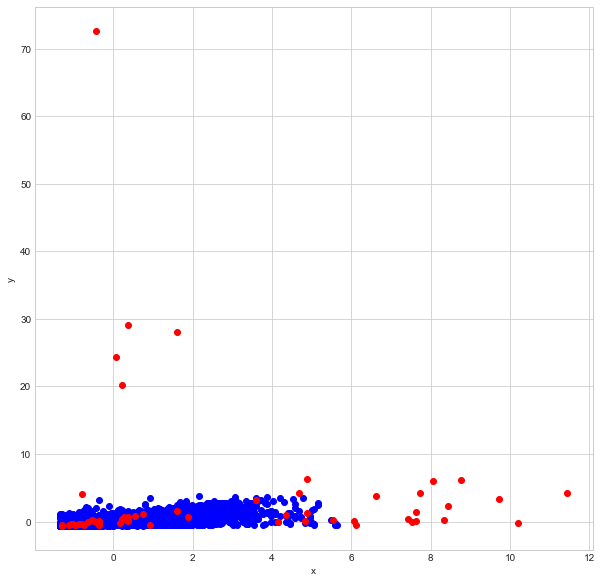

In [107]:
dbsc1 = dbscan_mvoutliers(FF_OR_Norm)

In [133]:
dbsc1.labels_
dbsc1.

30

In [111]:
len(dbsc1.labels_)

12012

In [141]:

# FF_OR_NA[V_O] - flatfile with only the rows that contain reservations data, without nulls and only the numeric columns.
#sns.distplot(FF_OR_NA[V_O].loc[dbsc1.labels_==-1,]),color=dbsc1.labels_)

## Treating outliers

In [ ]:
# After web research, we found that the weather data is sensible and probably correct, and decided to leave it.
# After looking at the outliers in visitors column(which is our 'Y' column), it is obvious that the outliers are due to incorrect insertion of data.
# So we decided to drop them.

In [140]:
FF_NR['visitors'].loc[outNR_visitors] = np.NaN
FF_OR['visitors'].loc[outOR_visitors] = np.NaN

In [139]:
FF_NR.loc[outNR_visitors]

,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover
17,ir_60a7057184ec7ec7,Izakaya,Fukuoka-ken Fukuoka-shi Torikai,33.575686,130.369976,2016-01-01,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,0.810861,0.811887,7.3,12.6,3.1,NaN,6.6,10.35,2.1,7.6,1029.2,76.0,1031.1,4.3
36,ir_d0a7bd3339c3d12a,Cafe/Sweets,Tokyo-to Taito-ku Higashiueno,35.712607,139.779996,2016-01-01,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,3.573166,3.572811,7.5,12.1,3.6,NaN,9.0,11.80,2.6,4.5,1022.4,45.0,1025.4,2.5
38,ir_d97dabf7aae60da5,Cafe/Sweets,Tokyo-to Shibuya-ku Jingūmae,35.669290,139.707056,2016-01-01,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,4.612713,4.609538,7.5,12.1,3.6,NaN,9.0,11.80,2.6,4.5,1022.4,45.0,1025.4,2.5
44,ir_f26f36ec4dc5adb0,Izakaya,Tokyo-to Shinjuku-ku Kabukicho,35.693840,139.703549,2016-01-01,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,4.211253,4.202990,7.5,12.1,3.6,NaN,9.0,11.80,2.6,4.5,1022.4,45.0,1025.4,2.5
76,ir_60a7057184ec7ec7,Izakaya,Fukuoka-ken Fukuoka-shi Torikai,33.575686,130.369976,2016-01-02,NaN,3217,Saturday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,0.810861,0.811887,11.6,14.7,8.3,0.0,0.6,5.00,2.2,9.4,1023.0,69.0,1024.8,10.0
81,ir_6b15edd1b4fbb96a,Italian/French,Shizuoka-ken Hamamatsu-shi Motoshirocho,34.710895,137.725940,2016-01-02,NaN,3217,Saturday,1,shizuoka__hamamatsu-kana__hamamatsu,34.753333,137.711667,4.885979,4.897191,8.5,14.8,2.0,NaN,9.1,NaN,3.4,6.2,1018.5,57.0,1024.4,NaN
85,ir_789466e488705c93,Izakaya,Fukuoka-ken Kurume-shi Jonanmachi,33.319286,130.508374,2016-01-02,NaN,3217,Saturday,1,fukuoka__kurume-kana__kurume,33.303333,130.493333,2.256617,2.258974,9.7,14.1,5.7,0.0,1.0,NaN,0.7,NaN,NaN,NaN,NaN,NaN
99,ir_d97dabf7aae60da5,Cafe/Sweets,Tokyo-to Shibuya-ku Jingūmae,35.669290,139.707056,2016-01-02,NaN,3217,Saturday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,4.612713,4.609538,7.3,13.4,2.6,NaN,7.5,11.59,1.9,5.2,1018.6,51.0,1021.5,4.3
101,ir_db80363d35f10926,Dining bar,Hokkaido Asahikawa-shi 6 Jodori,43.770635,142.364819,2016-01-02,NaN,3217,Saturday,1,hokkaido_kamikawa__asahikawa-kana__asahikawa,43.756667,142.371667,1.647083,1.648196,-0.9,0.6,-3.8,5.5,0.0,2.43,4.6,4.9,994.0,86.0,1011.6,9.8
106,ir_eb120e6d384a17a8,Cafe/Sweets,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-02,NaN,3217,Saturday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,11.6,14.7,8.3,0.0,0.6,5.00,2.2,9.4,1023.0,69.0,1024.8,10.0


# Missing Values

In [143]:
#pip install missingno
import missingno as msno

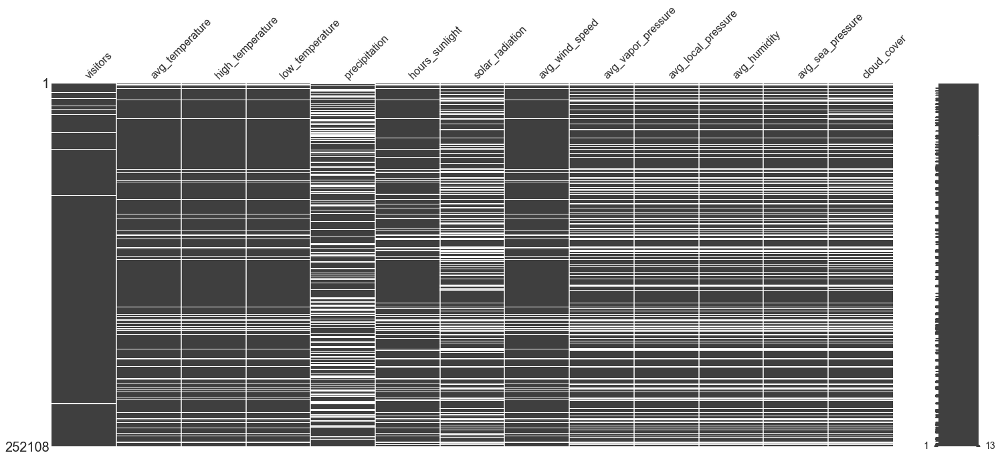

In [151]:
### plot the missingness (nullity) matrix
missingdata_df_NR = FF_NR.columns[FF_NR.isnull().any()].tolist()
msno.matrix(FF_NR[missingdata_df_NR])

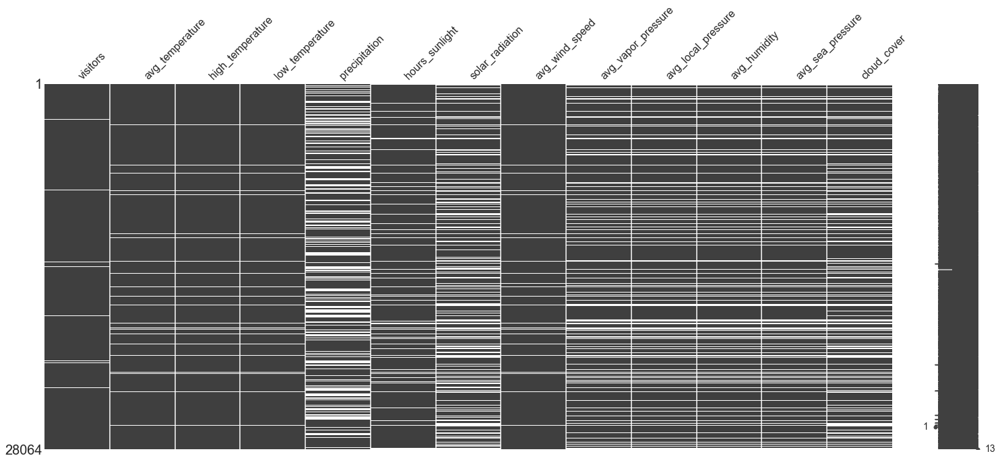

In [152]:
### plot the missingness (nullity) matrix
missingdata_df_OR = FF_OR.columns[FF_OR.isnull().any()].tolist()
msno.matrix(FF_OR[missingdata_df_OR])

## Missing Values Imputation

### Dropout

In [146]:
FF_NR2 = FF_NR.copy()
# drop rows with missing values
FF_NR2.dropna(inplace=True)
# summarize the number of rows and columns in the dataset
print(FF_NR2.shape)

FF_OR2 = FF_OR.copy()
# drop rows with missing values
FF_OR2.dropna(inplace=True)
# summarize the number of rows and columns in the dataset
print(FF_OR2.shape)

(97535, 27)
(11740, 28)


In [147]:
### check for changes in the statistics
print(FF_NR.describe())
print("----------------------------------------------------------------------------------")
print(FF_NR2.describe())

            latitude      longitude       visitors  daily_reservations    holiday_flg         st_lat        st_long    st_vincenty  st_great_circle  avg_temperature  high_temperature  low_temperature  precipitation  hours_sunlight  solar_radiation  avg_wind_speed  avg_vapor_pressure  avg_local_pressure   avg_humidity  avg_sea_pressure    cloud_cover
count  252108.000000  252108.000000  245149.000000       252108.000000  252108.000000  252108.000000  252108.000000  252108.000000    252108.000000    227486.000000     227482.000000    227482.000000  175718.000000   216662.000000    169373.000000   227377.000000       186636.000000       186870.000000  186636.000000     186870.000000  177616.000000
mean       35.613121     137.357865      19.435706        24727.685353       0.050673      35.614647     137.357938       3.821379         3.821444        14.764283         19.125582        11.063648       6.095662        5.324347        12.720834        2.841797           13.408370         1010

In [148]:
### check for changes in the statistics
print(FF_OR.describe())
print("----------------------------------------------------------------------------------")
print(FF_OR2.describe())

           latitude     longitude     visitors  reservations  daily_reservations   holiday_flg        st_lat       st_long   st_vincenty  st_great_circle  avg_temperature  high_temperature  low_temperature  precipitation  hours_sunlight  solar_radiation  avg_wind_speed  avg_vapor_pressure  avg_local_pressure  avg_humidity  avg_sea_pressure   cloud_cover
count  28064.000000  28064.000000  27391.00000  28064.000000        28064.000000  28064.000000  28064.000000  28064.000000  28064.000000     28064.000000     26763.000000      26763.000000     26763.000000   18859.000000    25061.000000     19842.000000    26739.000000        22797.000000        22839.000000  22797.000000      22839.000000  20614.000000
mean      36.122509    137.117701     25.05312     13.751283        32852.914339      0.051454     36.125071    137.121526      3.603364         3.603472         8.846531         13.211643         4.917894       4.643724        5.350541        11.420090        3.085710            7.69656

### Machine Learning imputation: kNN imputation

In [ ]:
X_train = FF_NR2.copy()
fulldt = FF_NR
#X_train.dropna(inplace=True)
y_train = X_train.loc[:,missingdata_df_NR]
X_train = X_train.loc[:,(fulldt)]
print(y_train.shape)
print(X_train.shape)

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
reg = KNeighborsRegressor(n_neighbors=5)  
reg.fit(X_train, y_train)  

In [ ]:
X_test = X2.loc[(X2[<<var_with_miss].isnull()),fulldt]
y_pred = reg.predict(X_test)

In [ ]:
len(y_pred)
y_train1 = pd.DataFrame({'y':y_train, 'miss_var':X_train['miss_var']})
y_train1[<<other_var>>] = 0

y_pred1 = pd.DataFrame({'y':y_pred, 'miss_var':X_test['miss_var']})
y_pred1[<<other_var>>] = 1

y = pd.concat([y_train1,y_pred1])
y.head()

In [ ]:
### plot the vars
sns.scatterplot(x='miss_var',y='y', data=y,hue=<<other_var>>)

In [ ]:
from fancyimpute import KNN    
# X is the complete data matrix
# X_incomplete has the same values as X except a subset have been replace with NaN

# Use 3 nearest rows which have a feature to fill in each row's missing features
X_filled_knn = KNN(k=3).complete(X_incomplete)

# Detecting missing values

### Using isnull() to find missing data is not enough,<br/>Sometimes a cell could have data that isn't identified as null but has no sensible meaning in that field,<br/>Hence, the data in that cell is considered "missing".

In [ ]:
# Detecting numbers 
cnt=0
for row in df['OWN_OCCUPIED']:
    try:
        int(row)
        df.loc[cnt, 'OWN_OCCUPIED']=np.nan
    except ValueError:
        pass
    cnt+=1

In [ ]:
'visitors','avg_local_pressure', 'avg_humidity','avg_sea_pressure'

In [7]:
### Found a mistake in columns order and fixed it
#

In [172]:
Vnames = list(FF.columns.values)
Vnames[7]

'reservations'

In [5]:
Vnames = ['air_store_id', 'air_genre_name', 'air_area_name', 'latitude', 'longitude', 'visit_date', 'visitors', 'reservations',
 'daily_reservations', 'dow', 'holiday_flg', 'station_id', 'st_lat', 'st_long', 'st_vincenty', 'st_great_circle',
 'avg_temperature', 'high_temperature', 'low_temperature', 'precipitation', 'hours_sunlight', 'solar_radiation',
 'deepest_snowfall', 'total_snowfall', 'avg_wind_speed', 'avg_vapor_pressure', 'avg_local_pressure', 'avg_humidity',
 'avg_sea_pressure', 'cloud_cover']
PPnames = ['air_store_id', 'air_genre_name', 'air_area_name', 'latitude', 'longitude', 'visit_date', 'visitors', 'reservations',
 'daily_reservations', 'dow', 'holiday_flg', 'st_vincenty',
 'avg_temperature', 'high_temperature', 'low_temperature', 'precipitation', 'hours_sunlight']

In [252]:
FF['visit_date'] =  pd.to_datetime(FF['visit_date'], format = '%Y-%m-%d')
FF['year'] = FF['visit_date'].dt.year
FF['month'] = FF['visit_date'].dt.month
FF['week'] = FF['visit_date'].dt.week
FF['day'] = FF['visit_date'].dt.day
FF['day_of_week'] = FF['visit_date'].dt.day_name()
FF['year_week'] =FF['visit_date'].dt.strftime("%Y")+"_"+FF['visit_date'].dt.strftime("%w")
FF = pd.merge(FF, FF.groupby([FF['year_week']])['visitors'].sum().reset_index(name='week_total').sort_values('year_week'),  how='left', left_on='year_week',right_on='year_week')
#FF = pd.merge(FF, FF.groupby([FF['air_store_id','year_week']])['visitors'].sum().reset_index(name='store_week_total').sort_values('air_store_id','year_week'),  how='left', left_on=['air_store_id','year_week'],right_on=['air_store_id','year_week'])
FF['area1'],FF['area2'],FF['area3'] = FF['air_area_name'].str.split('-').str
FF['area1_2'] =FF['area1']+"_"+FF['area2']



In [140]:
FF.groupby([FF['air_store_id','year_week']])['visitors'].sum()#.reset_index(name='store_week_total').sort_values('air_store_id','year_week')

In [143]:
FF = pd.merge(FF, Weather,  how='left', left_on=['date_visit','air_store_id'],right_on=['calendar_date','air_store_id'])

,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,year,month,week,day,day_of_week,year_week,week_total_x,area1,area2,area3,area1_2,week_total_y,week_total_x,week_total_y,week_total
0,ir_04341b588bde96cd,Izakaya,Tokyo-to Nerima-ku Toyotamakita,35.735623,139.651658,2016-01-01,10,NaN,510,Friday,1,tokyo__nerima-kana__nerima,35.738333,139.591667,5.435240,5.424557,6.9,11.8,2.1,0.0,9.1,NaN,NaN,NaN,1.8,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_5,5165,Tokyo,to Nerima,ku Toyotamakita,Tokyo_to Nerima,5165,5165,5165,643375
1,ir_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-01,29,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,7.3,12.6,3.1,NaN,6.6,10.35,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3,2016,1,53,1,Friday,2016_5,5165,Fukuoka,ken Fukuoka,shi Daimyo,Fukuoka_ken Fukuoka,5165,5165,5165,643375
2,ir_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,11,NaN,510,Friday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,2.4,6.1,-1.5,0.0,3.7,5.71,NaN,NaN,2.8,4.6,1019.1,64.0,1024.7,4.0,2016,1,53,1,Friday,2016_5,5165,Miyagi,ken Sendai,shi Kamisugi,Miyagi_ken Sendai,5165,5165,5165,643375
3,ir_09a845d5b5944b01,Izakaya,Fukuoka-ken Kurume-shi Jonanmachi,33.319286,130.508374,2016-01-01,56,NaN,510,Friday,1,fukuoka__kurume-kana__kurume,33.303333,130.493333,2.256617,2.258974,5.9,11.1,1.9,0.0,7.3,NaN,NaN,NaN,1.2,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_5,5165,Fukuoka,ken Kurume,shi Jonanmachi,Fukuoka_ken Kurume,5165,5165,5165,643375
4,ir_1f7f8fa557bc0d55,Bar/Cocktail,Osaka-fu Neyagawa-shi Honmachi,34.766093,135.628100,2016-01-01,6,NaN,510,Friday,1,Osaka__hirakata-kana__hirakata,34.808333,135.671667,6.152897,6.157249,5.5,11.9,1.0,0.0,6.0,NaN,NaN,NaN,0.8,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_5,5165,Osaka,fu Neyagawa,shi Honmachi,Osaka_fu Neyagawa,5165,5165,5165,643375
5,ir_2570ccb93badde68,Izakaya,Tokyo-to Shinjuku-ku Kabukicho,35.693840,139.703549,2016-01-01,43,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,4.211253,4.202990,7.5,12.1,3.6,NaN,9.0,11.80,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,2016,1,53,1,Friday,2016_5,5165,Tokyo,to Shinjuku,ku Kabukicho,Tokyo_to Shinjuku,5165,5165,5165,643375
6,ir_25d8e5cc57dd87d9,Western food,Tokyo-to Shibuya-ku Shibuya,35.661777,139.704051,2016-01-01,1,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,5.319959,5.318636,7.5,12.1,3.6,NaN,9.0,11.80,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,2016,1,53,1,Friday,2016_5,5165,Tokyo,to Shibuya,ku Shibuya,Tokyo_to Shibuya,5165,5165,5165,643375
7,ir_298513175efdf261,Cafe/Sweets,Fukuoka-ken Fukuoka-shi Torikai,33.575686,130.369976,2016-01-01,12,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,0.810861,0.811887,7.3,12.6,3.1,NaN,6.6,10.35,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3,2016,1,53,1,Friday,2016_5,5165,Fukuoka,ken Fukuoka,shi Torikai,Fukuoka_ken Fukuoka,5165,5165,5165,643375
8,ir_35c4732dcbfe31be,Dining bar,Hyogo-ken Kobe-shi Kumoidori,34.695124,135.197852,2016-01-01,16,NaN,510,Friday,1,hyogo__kobe-kana__koube,34.696667,135.211667,1.277232,1.274882,7.9,12.3,4.8,0.0,8.6,NaN,NaN,NaN,2.8,6.2,1025.8,59.0,1029.6,1.8,2016,1,53,1,Friday,2016_5,5165,Hyogo,ken Kobe,shi Kumoidori,Hyogo_ken Kobe,5165,5165,5165,643375
9,ir_36bcf77d3382d36e,Bar/Cocktail,Tokyo-to Chiyoda-ku Kudanminami,35.694003,139.753595,2016-01-01,34,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,0.416011,0.415906,7.5,12.1,3.6,NaN,9.0,11.80,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,2016,1,53,1,Friday,2016_5,5165,Tokyo,to Chiyoda,ku Kudanminami,Tokyo_to Chiyoda,5165,5165,5165

## שדות מחושבים כמו ממוצע מבקרים<br/>יש לעשות רק אחרי טיפול בנתונים קיצוניים ובחוסרים<br/>כי זה יעוות את הנתונים לפני

In [ ]:
avg_vis_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['visitors'].mean().reset_index(name='avg_vis_day').sort_values('visit_date')
FF = pd.merge(FF, FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['visitors'].mean().reset_index(name='avg_vis_day').sort_values('visit_date'),  how='left', left_on='visit_date',right_on='visit_date')
FF = pd.merge(FF, FF.groupby([FF['year_week']])['visitors'].mean().reset_index(name='avg_vis_week').sort_values('year_week'),  how='left', left_on='year_week',right_on='year_week')

# Average Data - Create average data fields

# Average Visitors per ['day_of_week']
FF = pd.merge(FF, FF.groupby([FF['day_of_week']])['visitors'].mean().reset_index(name='avg_vis_dow').sort_values('day_of_week'),  how='left', left_on='day_of_week',right_on='day_of_week')


FF = pd.merge(FF, FF.groupby([FF['area1']])['visitors'].mean().reset_index(name='avg_vis_area1').sort_values('area1'),  how='left', left_on='area1',right_on='area1')

# Average Visitors per ['day_of_week','area1']
FF = pd.merge(FF, FF.groupby([FF['day_of_week','area1']])['visitors'].mean().reset_index(name='avg_vis_dow_area1').sort_values('day_of_week','area1'),  how='left', left_on=['day_of_week','area1'],right_on=['day_of_week','area1'])

# Average Visitors per ['day_of_week','area1','holiday_flg']
FF = pd.merge(FF, FF.groupby([FF['day_of_week','area1','holiday_flg']])['visitors'].mean().reset_index(name='avg_vis_dow_genre').sort_values('day_of_week','area1','holiday_flg'),  how='left', left_on=['day_of_week','area1'],right_on=['day_of_week','area1','holiday_flg'])
                                                                                                                                
# Average Visitors per ['day_of_week']
FF = pd.merge(FF, FF.groupby([FF['day_of_week','air_genre_name']])['visitors'].mean().reset_index(name='avg_vis_dow_genre').sort_values('day_of_week','air_genre_name'),  how='left', left_on=['day_of_week','air_genre_name'],right_on=['day_of_week','air_genre_name'])
                                                                                                                                
# Average Visitors per ['day_of_week']
FF = pd.merge(FF, FF.groupby([FF['day_of_week','air_genre_name']])['visitors'].mean().reset_index(name='avg_vis_dow_genre').sort_values('day_of_week','air_genre_name'),  how='left', left_on=['day_of_week','air_genre_name'],right_on=['day_of_week','air_genre_name'])

# Day of week
FF = pd.merge(FF, FF.groupby([FF['day_of_week']])['visitors'].mean().reset_index(name='avg_vis_dow').sort_values('day_of_week'),  how='left', left_on='day_of_week',right_on='day_of_week')
FF = pd.merge(FF, FF.groupby([FF['day_of_week','area1']])['visitors'].mean().reset_index(name='avg_vis_dow_area1').sort_values(['day_of_week','area1'),  how='left', left_on=['day_of_week','area1'],right_on=['day_of_week','area1'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week','air_genre_name']])['visitors'].mean().reset_index(name='avg_vis_dow_genre').sort_values('day_of_week','air_genre_name'),  how='left', left_on=['day_of_week','air_genre_name'],right_on=['day_of_week','air_genre_name'])

# Month
FF = pd.merge(FF, FF.groupby([FF['day_of_week']])['visitors'].mean().reset_index(name='avg_vis_dow').sort_values('day_of_week'),  how='left', left_on='day_of_week',right_on='day_of_week')
FF = pd.merge(FF, FF.groupby([FF['day_of_week','area1']])['visitors'].mean().reset_index(name='avg_vis_dow_area1').sort_values(['day_of_week','area1'),  how='left', left_on=['day_of_week','area1'],right_on=['day_of_week','area1'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week','air_genre_name']])['visitors'].mean().reset_index(name='avg_vis_dow_genre').sort_values('day_of_week','air_genre_name'),  how='left', left_on=['day_of_week','air_genre_name'],right_on=['day_of_week','air_genre_name'])

# Holliday flag
FF = pd.merge(FF, FF.groupby([FF['day_of_week']])['visitors'].mean().reset_index(name='avg_vis_dow').sort_values('day_of_week'),  how='left', left_on='day_of_week',right_on='day_of_week')
FF = pd.merge(FF, FF.groupby([FF['day_of_week','area1']])['visitors'].mean().reset_index(name='avg_vis_dow_area1').sort_values(['day_of_week','area1'),  how='left', left_on=['day_of_week','area1'],right_on=['day_of_week','area1'])
FF = pd.merge(FF, FF.groupby([FF['day_of_week','air_genre_name']])['visitors'].mean().reset_index(name='avg_vis_dow_genre').sort_values('day_of_week','air_genre_name'),  how='left', left_on=['day_of_week','air_genre_name'],right_on=['day_of_week','air_genre_name'])


In [179]:
FF = pd.merge(FF, FF.groupby([FF['area1']])['visitors'].mean().reset_index(name='avg_vis_area1').sort_values('area1'),  how='left', left_on='area1',right_on='area1')

In [181]:
FF

,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,year,month,week,day,day_of_week,year_week,week_total_x,area1,area2,area3,area1_2,week_total_y,week_total_x,week_total_y,week_total,avg_vis_area1
0,ir_04341b588bde96cd,Izakaya,Tokyo-to Nerima-ku Toyotamakita,35.735623,139.651658,2016-01-01,10,NaN,510,Friday,1,tokyo__nerima-kana__nerima,35.738333,139.591667,5.435240,5.424557,6.9,11.8,2.1,0.0,9.1,NaN,NaN,NaN,1.8,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_5,5165,Tokyo,to Nerima,ku Toyotamakita,Tokyo_to Nerima,5165,5165,5165,643375,20.484162
1,ir_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-01,29,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,7.3,12.6,3.1,NaN,6.6,10.35,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3,2016,1,53,1,Friday,2016_5,5165,Fukuoka,ken Fukuoka,shi Daimyo,Fukuoka_ken Fukuoka,5165,5165,5165,643375,20.434758
2,ir_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,11,NaN,510,Friday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,2.4,6.1,-1.5,0.0,3.7,5.71,NaN,NaN,2.8,4.6,1019.1,64.0,1024.7,4.0,2016,1,53,1,Friday,2016_5,5165,Miyagi,ken Sendai,shi Kamisugi,Miyagi_ken Sendai,5165,5165,5165,643375,20.463668
3,ir_09a845d5b5944b01,Izakaya,Fukuoka-ken Kurume-shi Jonanmachi,33.319286,130.508374,2016-01-01,56,NaN,510,Friday,1,fukuoka__kurume-kana__kurume,33.303333,130.493333,2.256617,2.258974,5.9,11.1,1.9,0.0,7.3,NaN,NaN,NaN,1.2,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_5,5165,Fukuoka,ken Kurume,shi Jonanmachi,Fukuoka_ken Kurume,5165,5165,5165,643375,20.434758
4,ir_1f7f8fa557bc0d55,Bar/Cocktail,Osaka-fu Neyagawa-shi Honmachi,34.766093,135.628100,2016-01-01,6,NaN,510,Friday,1,Osaka__hirakata-kana__hirakata,34.808333,135.671667,6.152897,6.157249,5.5,11.9,1.0,0.0,6.0,NaN,NaN,NaN,0.8,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_5,5165,Osaka,fu Neyagawa,shi Honmachi,Osaka_fu Neyagawa,5165,5165,5165,643375,21.342272
5,ir_2570ccb93badde68,Izakaya,Tokyo-to Shinjuku-ku Kabukicho,35.693840,139.703549,2016-01-01,43,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,4.211253,4.202990,7.5,12.1,3.6,NaN,9.0,11.80,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,2016,1,53,1,Friday,2016_5,5165,Tokyo,to Shinjuku,ku Kabukicho,Tokyo_to Shinjuku,5165,5165,5165,643375,20.484162
6,ir_25d8e5cc57dd87d9,Western food,Tokyo-to Shibuya-ku Shibuya,35.661777,139.704051,2016-01-01,1,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,5.319959,5.318636,7.5,12.1,3.6,NaN,9.0,11.80,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,2016,1,53,1,Friday,2016_5,5165,Tokyo,to Shibuya,ku Shibuya,Tokyo_to Shibuya,5165,5165,5165,643375,20.484162
7,ir_298513175efdf261,Cafe/Sweets,Fukuoka-ken Fukuoka-shi Torikai,33.575686,130.369976,2016-01-01,12,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,0.810861,0.811887,7.3,12.6,3.1,NaN,6.6,10.35,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3,2016,1,53,1,Friday,2016_5,5165,Fukuoka,ken Fukuoka,shi Torikai,Fukuoka_ken Fukuoka,5165,5165,5165,643375,20.434758
8,ir_35c4732dcbfe31be,Dining bar,Hyogo-ken Kobe-shi Kumoidori,34.695124,135.197852,2016-01-01,16,NaN,510,Friday,1,hyogo__kobe-kana__koube,34.696667,135.211667,1.277232,1.274882,7.9,12.3,4.8,0.0,8.6,NaN,NaN,NaN,2.8,6.2,1025.8,59.0,1029.6,1.8,2016,1,53,1,Friday,2016_5,5165,Hyogo,ken Kobe,shi Kumoidori,Hyogo_ken Kobe,5165,5165,5165,643375,23.284209
9,ir_36bcf77d3382d36e,Bar/Cocktail,Tokyo-to Chiyoda-ku Kudanminami,35.694003,139.753595,2016-01-01,34,NaN,510,Friday,1,tokyo__tokyo-kana__tonokyo,35.691667,139.750000,0.416011,0.415906,7.5,12.1,3.6,NaN,9.0,11.80,NaN,NaN,2.6,4.5,1022.4,45.0,1

In [ ]:
ct = pd.crosstab(index=FF["day_of_week"], columns=[FF["air_genre_name"]], margins=True, values=(FF["visitors"]/FF["week_total"]), aggfunc='sum')

fig, ax = plt.subplots(figsize=(len(FF["air_genre_name"].unique()),len(FF["day_of_week"].unique())))
sns.heatmap(ct, annot=True, linewidths=.5, ax=ax, cmap=sns.color_palette("autumn_r",15))

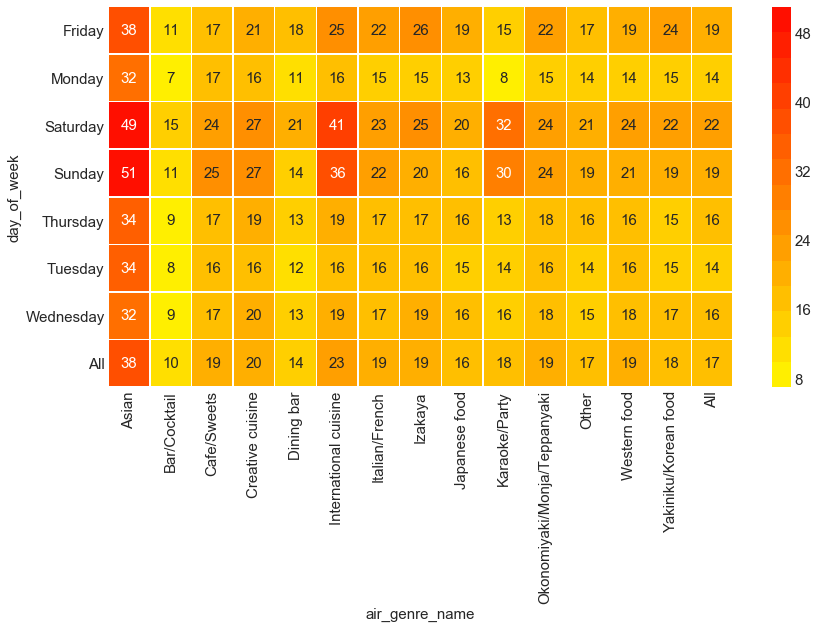

In [111]:
ct = pd.crosstab(index=FF["day_of_week"], columns=[FF["air_genre_name"]], margins=True, values=FF["visitors"], aggfunc='median')

fig, ax = plt.subplots(figsize=(len(FF["air_genre_name"].unique()),len(FF["day_of_week"].unique())))
sns.heatmap(ct, annot=True, linewidths=.5, ax=ax, cmap=sns.color_palette("autumn_r",15))


In [315]:
make_one_hot(FF,'day_of_week')
make_one_hot(FF,'air_genre_name')
make_one_hot(FF,'area1')
make_one_hot(FF,'area1_2')

In [53]:
from scipy.stats import kurtosis,skew
data = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['reservations'].sum().reset_index(name='number of reservations').sort_values('visit_date')
data = data['number of reservations'].to_frame(name='number of reservations')

mean :  807.3556485355649
var  :  877034.212426253
skew :  1.4986633716845517
kurt :  1.7668920695318802


(array([106.,  35.,  24.,  36.,  34.,  18.,  10.,  12.,  12.,  12.,   6.,  15.,   5.,  15.,  12.,  15.,  11.,   3.,   7.,   6.,   6.,   3.,   6.,   4.,   3.,   1.,   3.,   4.,   5.,   1.,   2.,   1.,   2.,   6.,   3.,   3.,   8.,   2.,   3.,   2.,   2.,   2.,   2.,   2.,   1.,   0.,   0.,   1.,   2.,   0.,   0.,   0.,   0.,   1.,   0.,   1.,   0.,   1.,   0.,   1.]),
 array([   0.        ,   76.98333333,  153.96666667,  230.95      ,  307.93333333,  384.91666667,  461.9       ,  538.88333333,  615.86666667,  692.85      ,  769.83333333,  846.81666667,  923.8       , 1000.78333333, 1077.76666667, 1154.75      , 1231.73333333, 1308.71666667, 1385.7       , 1462.68333333, 1539.66666667, 1616.65      , 1693.63333333, 1770.61666667, 1847.6       , 1924.58333333, 2001.56666667, 2078.55      , 2155.53333333, 2232.51666667, 2309.5       , 2386.48333333, 2463.46666667, 2540.45      , 2617.43333333, 2694.41666667, 2771.4       , 2848.38333333, 2925.36666667, 3002.35      ,
        3079.33333333,

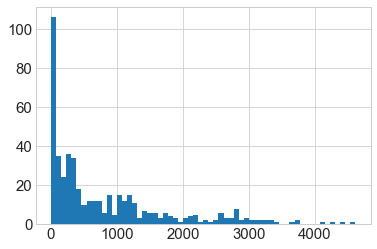

In [57]:
print("mean : ", np.mean(data['number of reservations']))
print("var  : ", np.var(data['number of reservations']))
print("skew : ",skew(data['number of reservations']))
print("kurt : ",kurtosis(data['number of reservations']))

plt.hist(np.transpose(data['number of reservations']), bins=60)

In [35]:
FF.dtypes

air_store_id                  object
air_genre_name                object
air_area_name                 object
latitude                     float64
longitude                    float64
visit_date            datetime64[ns]
visitors                       int64
reservations                 float64
daily_reservations             int64
dow                           object
holiday_flg                    int64
station_id                    object
st_lat                       float64
st_long                      float64
st_vincenty                  float64
st_great_circle              float64
avg_temperature              float64
high_temperature             float64
low_temperature              float64
precipitation                float64
hours_sunlight               float64
solar_radiation              float64
deepest_snowfall             float64
total_snowfall               float64
avg_wind_speed               float64
avg_vapor_pressure           float64
avg_local_pressure           float64
a

In [10]:
FF.head(5)

,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,station_id,st_lat,st_long,st_vincenty,st_great_circle,avg_temperature,high_temperature,low_temperature,precipitation,hours_sunlight,solar_radiation,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,year,month,week,day,day_of_week,year_week,week_total,area1,area2,area3,area1_2
0,ir_04341b588bde96cd,Izakaya,Tokyo-to Nerima-ku Toyotamakita,35.735623,139.651658,2016-01-01,10,NaN,510,Friday,1,tokyo__nerima-kana__nerima,35.738333,139.591667,5.435240,5.424557,6.9,11.8,2.1,0.0,9.1,NaN,NaN,NaN,1.8,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_00,5165,Tokyo,to Nerima,ku Toyotamakita,Tokyo_to Nerima
1,ir_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-01,29,NaN,510,Friday,1,fukuoka__fukuoka-kana__fukuoka,33.581667,130.375000,1.853535,1.851854,7.3,12.6,3.1,NaN,6.6,10.35,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3,2016,1,53,1,Friday,2016_00,5165,Fukuoka,ken Fukuoka,shi Daimyo,Fukuoka_ken Fukuoka
2,ir_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,11,NaN,510,Friday,1,miyagi__sendai-kana__sendai,38.261667,140.896667,2.441192,2.437165,2.4,6.1,-1.5,0.0,3.7,5.71,NaN,NaN,2.8,4.6,1019.1,64.0,1024.7,4.0,2016,1,53,1,Friday,2016_00,5165,Miyagi,ken Sendai,shi Kamisugi,Miyagi_ken Sendai
3,ir_09a845d5b5944b01,Izakaya,Fukuoka-ken Kurume-shi Jonanmachi,33.319286,130.508374,2016-01-01,56,NaN,510,Friday,1,fukuoka__kurume-kana__kurume,33.303333,130.493333,2.256617,2.258974,5.9,11.1,1.9,0.0,7.3,NaN,NaN,NaN,1.2,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_00,5165,Fukuoka,ken Kurume,shi Jonanmachi,Fukuoka_ken Kurume
4,ir_1f7f8fa557bc0d55,Bar/Cocktail,Osaka-fu Neyagawa-shi Honmachi,34.766093,135.628100,2016-01-01,6,NaN,510,Friday,1,Osaka__hirakata-kana__hirakata,34.808333,135.671667,6.152897,6.157249,5.5,11.9,1.0,0.0,6.0,NaN,NaN,NaN,0.8,NaN,NaN,NaN,NaN,NaN,2016,1,53,1,Friday,2016_00,5165,Osaka,fu Neyagawa,shi Honmachi,Osaka_fu Neyagawa


In [318]:
FF.isna().sum()

air_store_id                                    0
air_genre_name                                  0
air_area_name                                   0
latitude                                        0
longitude                                       0
visit_date                                      0
visitors                                        0
reservations                               224044
daily_reservations                              0
dow                                             0
holiday_flg                                     0
station_id                                      0
st_lat                                          0
st_long                                         0
st_vincenty                                     0
st_great_circle                                 0
avg_temperature                             24622
high_temperature                            24626
low_temperature                             24626
precipitation                               76390


In [ ]:
#FF_daily = FF.groupby(['air_store_id', 'air_genre_name', 'air_area_name', 'visit_date', 'dow', 'holiday_flg']).agg({'daily_reservations':'mean', 'visitors': 'sum', 'reservations': 'sum'}).sort_values(['visit_date','air_store_id'])

In [132]:
FF.groupby([FF.visit_date.dt.strftime('%Y-%m')])['visitors'].mean().reset_index(name='Store daily average visitors').sort_values('visit_date')

,visit_date,Store daily average visitors
0,2016-01,20.891257
1,2016-02,21.032877
2,2016-03,22.866876
3,2016-04,22.533317
4,2016-05,22.009313
5,2016-06,21.319510
6,2016-07,21.267653
7,2016-08,19.748489
8,2016-09,19.908445
9,2016-10,20.319715


## Number of different stores visited each day

In [135]:
stores = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['air_store_id'].count().reset_index(name='number of different stores').sort_values('visit_date')
#stores

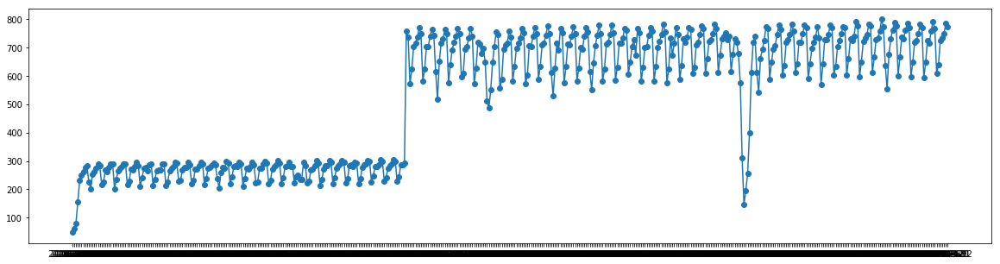

In [136]:
plt.figure(figsize=(20,5))
plt.plot_date(stores['visit_date'],stores['number of different stores'], linestyle='solid')

## Number of visitors each day

In [137]:
vis_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['visitors'].sum().reset_index(name='number of visitors').sort_values('visit_date')
#vis_day

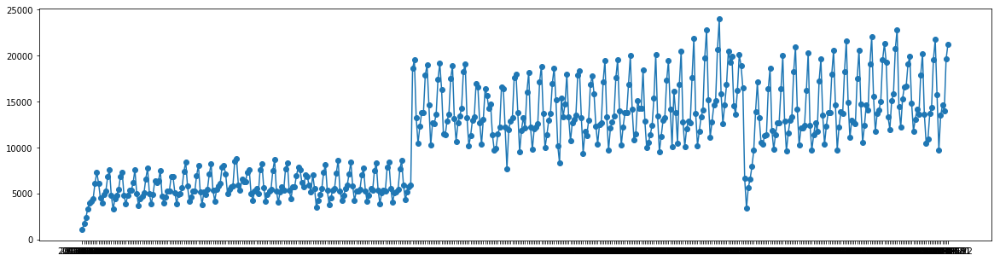

In [138]:
plt.figure(figsize=(20,5))
plt.plot_date(vis_day['visit_date'],vis_day['number of visitors'], linestyle='solid')

## Average number of visitors each day

In [139]:
avg_vis_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['visitors'].mean().reset_index(name='avg_vis_day').sort_values('visit_date')

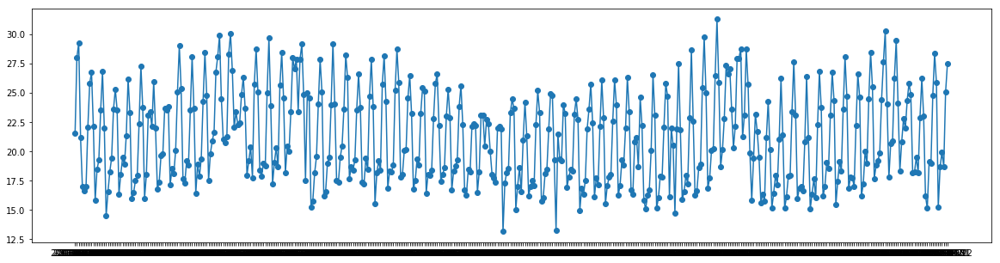

In [140]:
plt.figure(figsize=(20,5))
plt.plot_date(avg_vis_day['visit_date'],avg_vis_day['avg_vis_day'], linestyle='solid')

### By looking at the three graphs above,<br/>I suspect that there's high corralation between 'number of different stores' and 'number of visitors'

In [141]:
from scipy.stats import spearmanr
# calculate spearman's correlation
coef, p = spearmanr(stores['number of different stores'], vis_day['number of visitors'])
print('Spearmans correlation coefficient: %.3f' % coef)
# interpret the significance
alpha = 0.05
if p > alpha:
	print('Samples are uncorrelated (fail to reject H0) p=%.3f' % p)
else:
	print('Samples are correlated (reject H0) p=%.3f' % p)

Spearmans correlation coefficient: 0.910
Samples are correlated (reject H0) p=0.000


#### As i suspected, there's a high corralation between 'number of different stores' and 'number of visitors'.<br/>This means that 'number of visitors' will confuse the model, i will replace it with 'avg_vis_day'

In [9]:
FF['area1'].unique()

array(['Tokyo', 'Fukuoka', 'Miyagi', 'Osaka', 'Hyogo', 'Hiroshima', 'Hokkaido Sapporo', 'Hokkaido Asahikawa', 'Hokkaido Abashiri', 'Shizuoka', 'Niigata', 'Hokkaido Kato'], dtype=object)

In [134]:
vis_dow = FF.groupby(FF['day_of_week'])['visitors'].sum().reset_index(name='vis_dow').sort_values('day_of_week')
avg_vis_dow = FF.groupby(FF['day_of_week'])['visitors'].mean().reset_index(name='avg_vis_dow').sort_values('day_of_week')
med_vis_dow = FF.groupby(FF['day_of_week'])['visitors'].median().reset_index(name='med_vis_dow').sort_values('day_of_week')

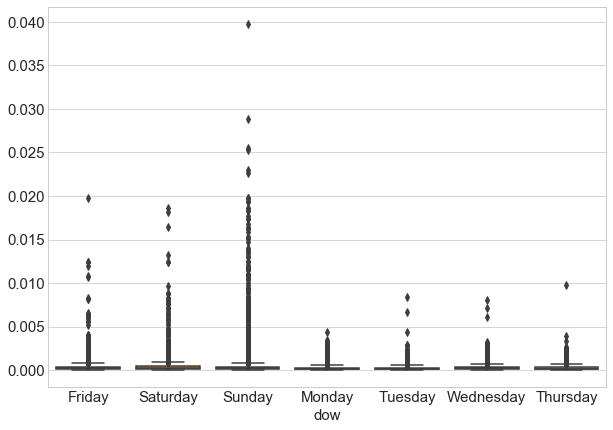

In [125]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,7))
sns.boxplot(FF['dow'], (FF['visitors']/FF['week_total']))
#sns.lineplot(avg_vis_dow['day_of_week'], avg_vis_dow['avg_vis_dow'])

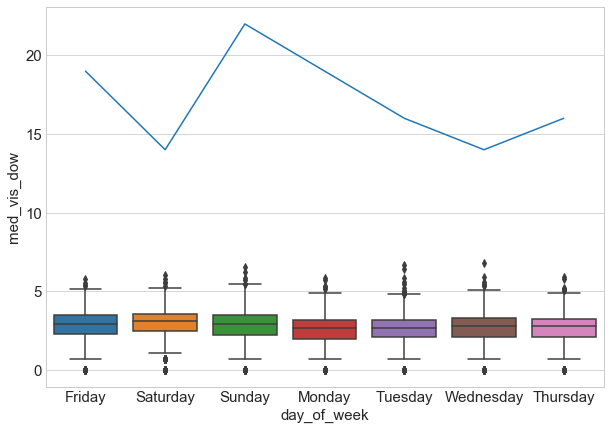

In [124]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(10,7))
sns.boxplot(FF['dow'], np.log(FF['visitors']))
sns.lineplot(med_vis_dow['day_of_week'], med_vis_dow['med_vis_dow'])

In [120]:
avg_vis_month = FF.groupby(FF['month'])['visitors'].mean().reset_index(name='avg_vis_month').sort_values('month')
med_vis_month = FF.groupby(FF['month'])['visitors'].median().reset_index(name='med_vis_month').sort_values('month')

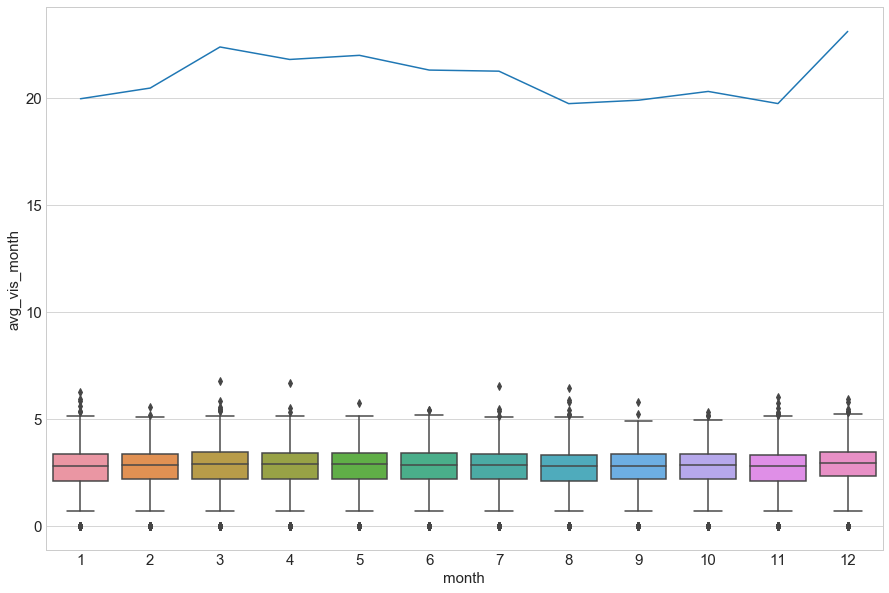

In [122]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(15,10))
sns.boxplot(FF['month'], np.log(FF['visitors']))
sns.lineplot(avg_vis_month['month']-1, avg_vis_month['avg_vis_month'])

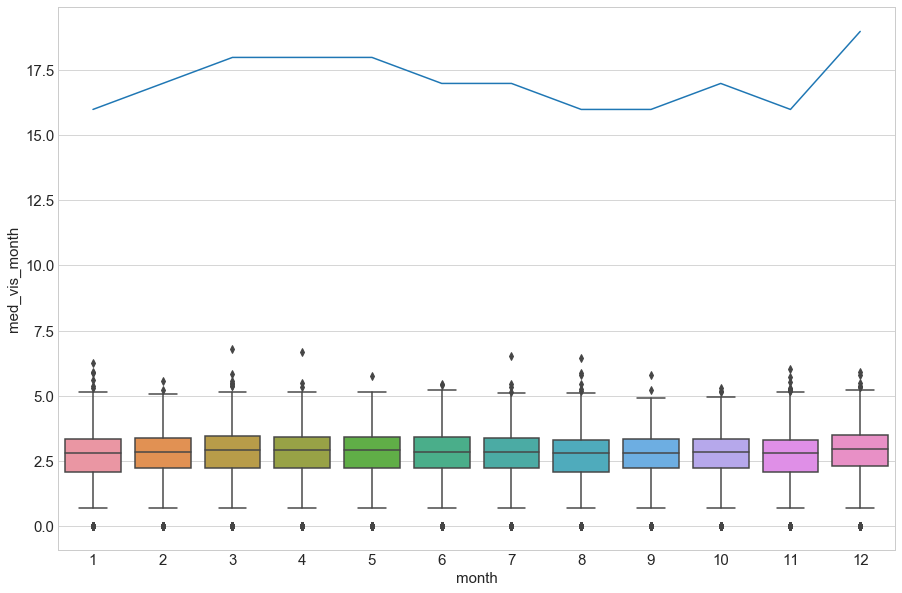

In [118]:
plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(15,10))
sns.boxplot(FF['month'], np.log(FF['visitors']))
sns.lineplot(med_vis_month['month']-1, med_vis_month['med_vis_month'])

## Number of reservations each day

In [6]:
res_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['reservations'].sum().reset_index(name='number of reservations').sort_values('visit_date')
#res_day

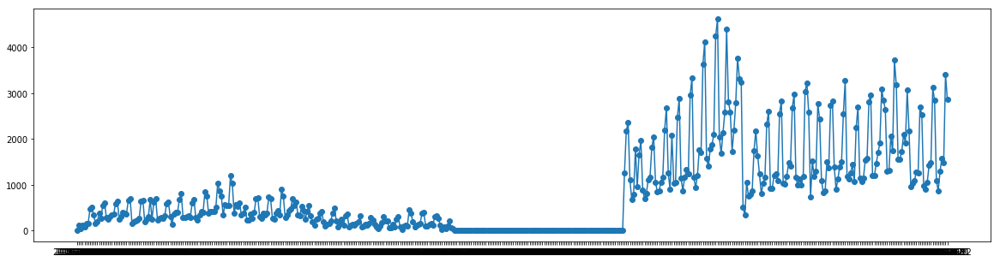

In [143]:
plt.figure(figsize=(20,5))
plt.plot_date(res_day['visit_date'],res_day['number of reservations'], linestyle='solid')

## Average number of reservations each day

In [144]:
avg_res_day = FF.groupby([FF.visit_date.dt.strftime('%Y-%m-%d')])['reservations'].mean().reset_index(name='avg_res_day').sort_values('visit_date')

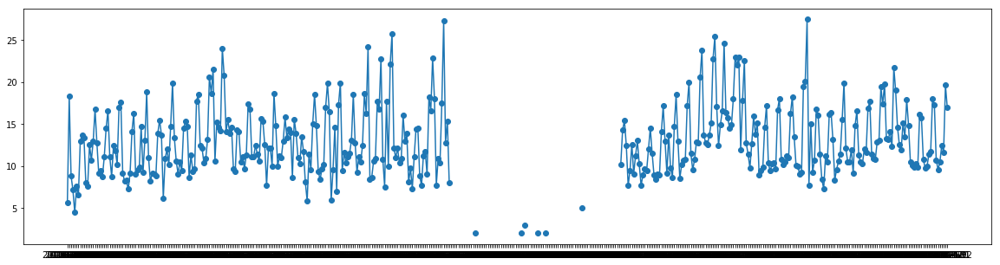

In [145]:
plt.figure(figsize=(20,5))
plt.plot_date(avg_res_day['visit_date'],avg_res_day['avg_res_day'], linestyle='solid')

## Graph of number of visitors per food genre by date

In [78]:
genres = FF.air_genre_name.unique()
vis_day_genre = FF.groupby(['visit_date','air_genre_name'])['visitors'].sum().reset_index(['visit_date','air_genre_name'])

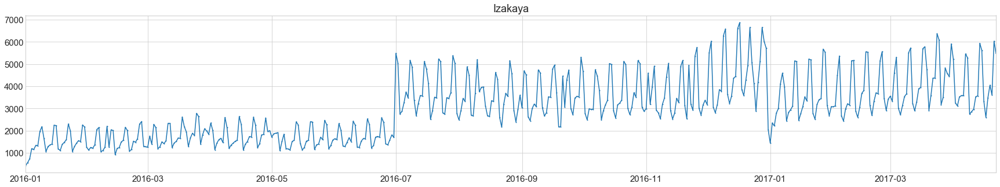

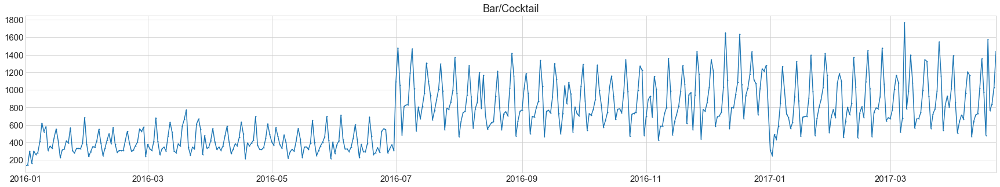

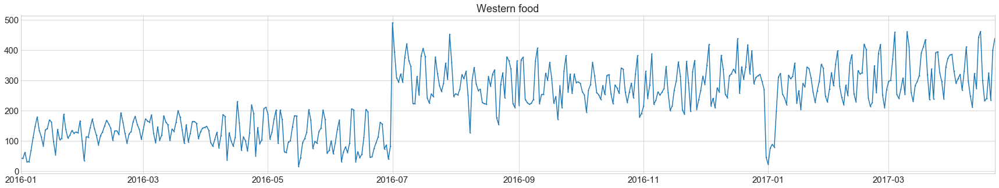

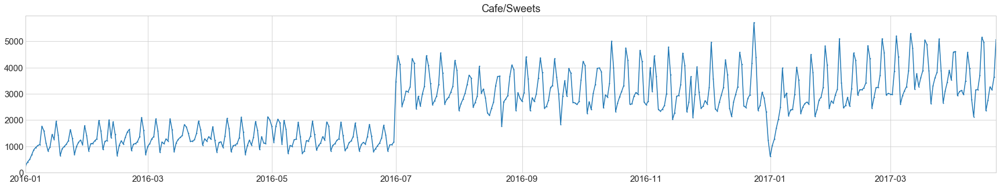

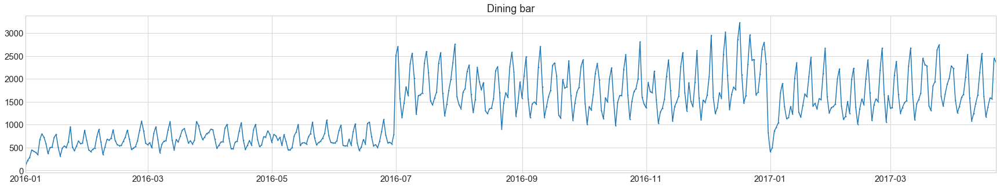

...

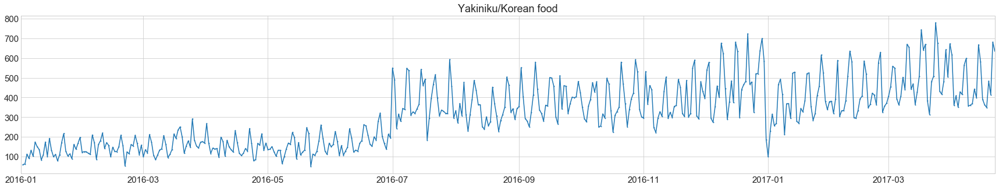

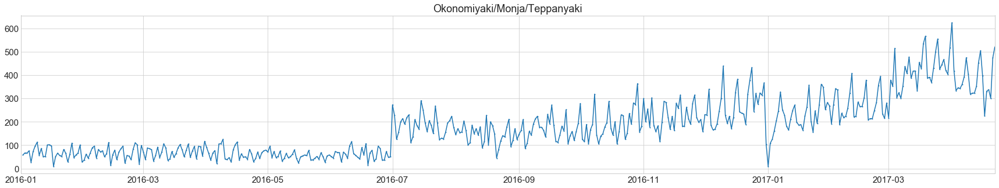

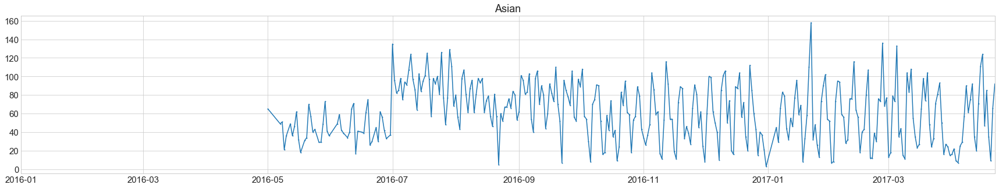

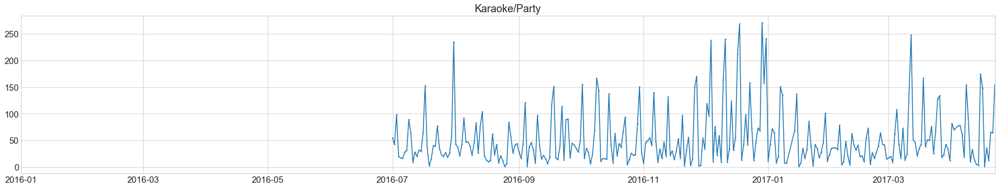

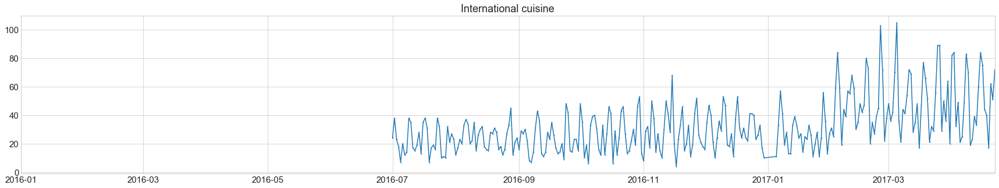

In [116]:
#plt.figure(figsize=(35,20))
#plt.yscale('log',basey=2) 
plt.rcParams.update({'font.size': 15})

#ax.xaxis.set_major_formatter(DateFormatter('%Y'))
datemin = dt.date(2016, 1, 1)
datemax = dt.date(2017, 4, 22)
#ax.set_xlim(datemin, datemax)

#x = 0
for i in genres:
    F = vis_day_genre[vis_day_genre.air_genre_name == i]

    plt.figure(figsize=(30,5))
    plt.xlim(datemin, datemax)    
    plt.plot_date(F['visit_date'],F['visitors'], linestyle='solid', ms=1, label = i)#, color = color)
    plt.title(i)
    #x = x + 1
    #plt.legend(i)



#plt.legend(loc='best')
#plt.plot_date(F['visit_date'],np.log(F['visitors']), linestyle='solid', ms=2)
#plt.legend(i)

## Graph of number of visitors per prefecture by date

In [149]:
area = FF.area1.unique()
vis_day_area1 = FF.groupby(['visit_date','area1'])['visitors'].sum().reset_index(['visit_date','area1'])

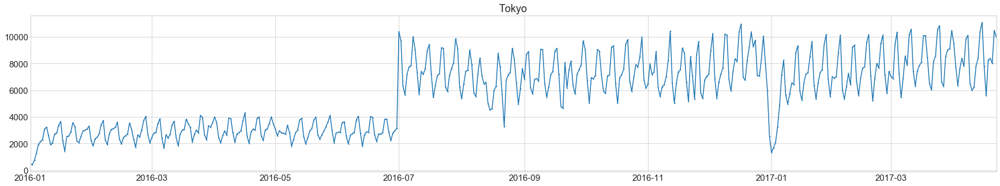

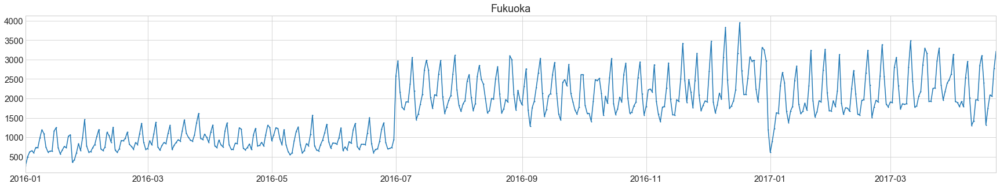

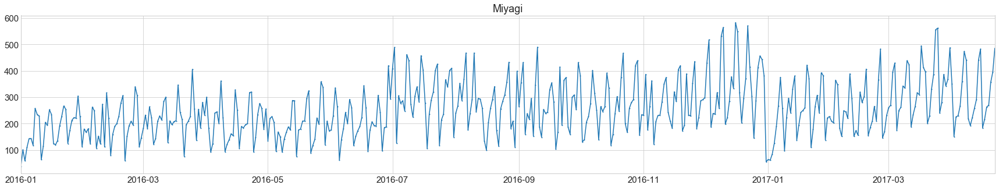

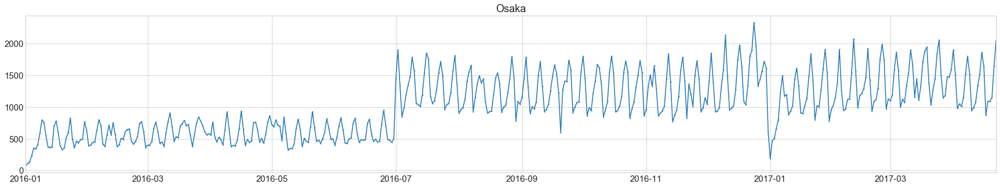

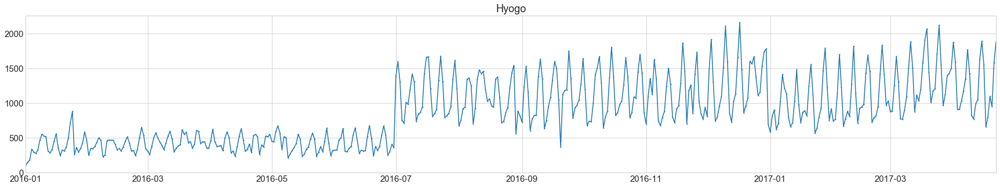

...

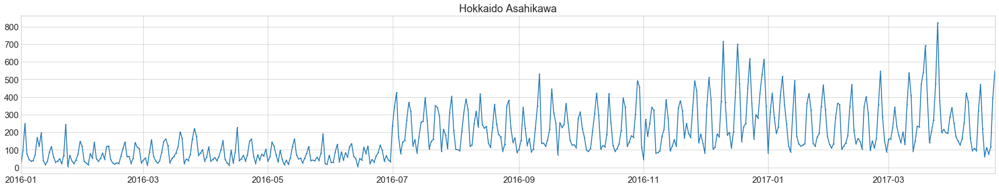

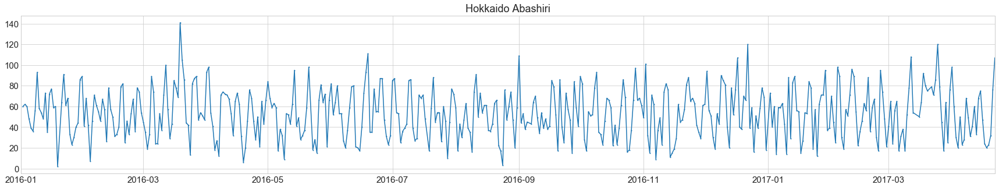

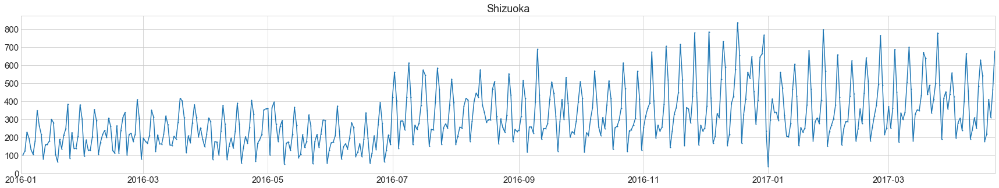

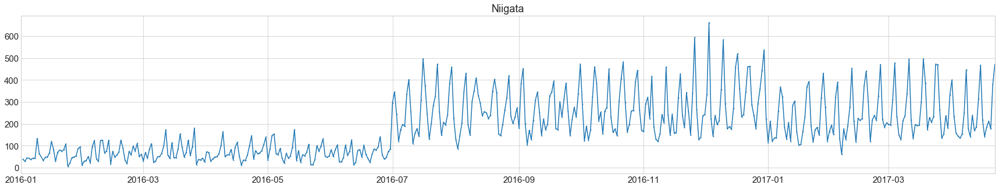

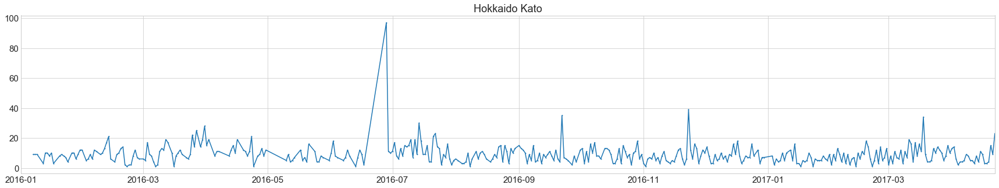

In [150]:
plt.rcParams.update({'font.size': 15})

#ax.xaxis.set_major_formatter(DateFormatter('%Y'))
datemin = dt.date(2016, 1, 1)
datemax = dt.date(2017, 4, 22)
#ax.set_xlim(datemin, datemax)

#x = 0
for i in area:
    F = vis_day_area1[vis_day_area1.area1 == i]

    plt.figure(figsize=(30,5))
    plt.xlim(datemin, datemax)    
    plt.plot_date(F['visit_date'],F['visitors'], linestyle='solid', ms=1, label = i)#, color = color)
    plt.title(i)

In [97]:
FF

,air_store_id,air_genre_name,air_area_name,latitude,longitude,visit_date,visitors,reservations,daily_reservations,dow,holiday_flg,...,deepest_snowfall,total_snowfall,avg_wind_speed,avg_vapor_pressure,avg_local_pressure,avg_humidity,avg_sea_pressure,cloud_cover,area1,area2,area3
0,ir_04341b588bde96cd,Izakaya,Tokyo-to Nerima-ku Toyotamakita,35.735623,139.651658,2016-01-01,10,NaN,510,Friday,1,...,NaN,NaN,1.8,NaN,NaN,NaN,NaN,NaN,Tokyo,to Nerima,ku Toyotamakita
1,ir_05c325d315cc17f5,Izakaya,Fukuoka-ken Fukuoka-shi Daimyo,33.589216,130.392813,2016-01-01,29,NaN,510,Friday,1,...,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3,Fukuoka,ken Fukuoka,shi Daimyo
2,ir_08ba8cd01b3ba010,Izakaya,Miyagi-ken Sendai-shi Kamisugi,38.269076,140.870403,2016-01-01,11,NaN,510,Friday,1,...,NaN,NaN,2.8,4.6,1019.1,64.0,1024.7,4.0,Miyagi,ken Sendai,shi Kamisugi
3,ir_09a845d5b5944b01,Izakaya,Fukuoka-ken Kurume-shi Jonanmachi,33.319286,130.508374,2016-01-01,56,NaN,510,Friday,1,...,NaN,NaN,1.2,NaN,NaN,NaN,NaN,NaN,Fukuoka,ken Kurume,shi Jonanmachi
4,ir_1f7f8fa557bc0d55,Bar/Cocktail,Osaka-fu Neyagawa-shi Honmachi,34.766093,135.628100,2016-01-01,6,NaN,510,Friday,1,...,NaN,NaN,0.8,NaN,NaN,NaN,NaN,NaN,Osaka,fu Neyagawa,shi Honmachi
5,ir_2570ccb93badde68,Izakaya,Tokyo-to Shinjuku-ku Kabukicho,35.693840,139.703549,2016-01-01,43,NaN,510,Friday,1,...,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,Tokyo,to Shinjuku,ku Kabukicho
6,ir_25d8e5cc57dd87d9,Western food,Tokyo-to Shibuya-ku Shibuya,35.661777,139.704051,2016-01-01,1,NaN,510,Friday,1,...,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,Tokyo,to Shibuya,ku Shibuya
7,ir_298513175efdf261,Cafe/Sweets,Fukuoka-ken Fukuoka-shi Torikai,33.575686,130.369976,2016-01-01,12,NaN,510,Friday,1,...,NaN,NaN,2.1,7.6,1029.2,76.0,1031.1,4.3,Fukuoka,ken Fukuoka,shi Torikai
8,ir_35c4732dcbfe31be,Dining bar,Hyogo-ken Kobe-shi Kumoidori,34.695124,135.197852,2016-01-01,16,NaN,510,Friday,1,...,NaN,NaN,2.8,6.2,1025.8,59.0,1029.6,1.8,Hyogo,ken Kobe,shi Kumoidori
9,ir_36bcf77d3382d36e,Bar/Cocktail,Tokyo-to Chiyoda-ku Kudanminami,35.694003,139.753595,2016-01-01,34,NaN,510,Friday,1,...,NaN,NaN,2.6,4.5,1022.4,45.0,1025.4,2.5,Tokyo,to Chiyoda,ku Kudanminami


In [17]:
FF['area1'].unique()

array(['Tokyo', 'Fukuoka', 'Miyagi', 'Osaka', 'Hyogo', 'Hiroshima', 'Hokkaido Sapporo', 'Hokkaido Asahikawa', 'Hokkaido Abashiri', 'Shizuoka', 'Niigata', 'Hokkaido Kato'], dtype=object)

## Need to seperate to two models
### 1st for all the stores, but with no reservations data,<br/>2nd for only stores that have reservation data.

### But first, I need to find the date at the end of the "zero plane" in the reservations data.

In [112]:
B=res_day.loc[res_day['number of reservations'] == 0]

NameError: name 'res_day' is not defined

### The last date with a zero is: "26/10/2016"<br/>This means that the reservations model starts on the "27/10/2016"

## Creating two flatfiles!

In [ ]:
FF_noRes = FF
del FF_noRes['reservations']

In [ ]:
FF_onlyRes = FF.loc[(FF['visit_date'] >= '2016-10-27') & (FF['reservations'] != 0)]

In [34]:
FF.shape

(252108, 41)

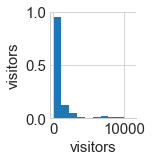

In [148]:
# מספר מקסימלי של מבקרים למסעדה ביום
# 
sns.pairplot(vis_day_area1)

# for pairplot,<br/>need to group by date only, because it remove categorized fields anyways,<br/>and leaving them distort the looks of the graph!

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\histograms.py:754: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\numpy\lib\histograms.py:755: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


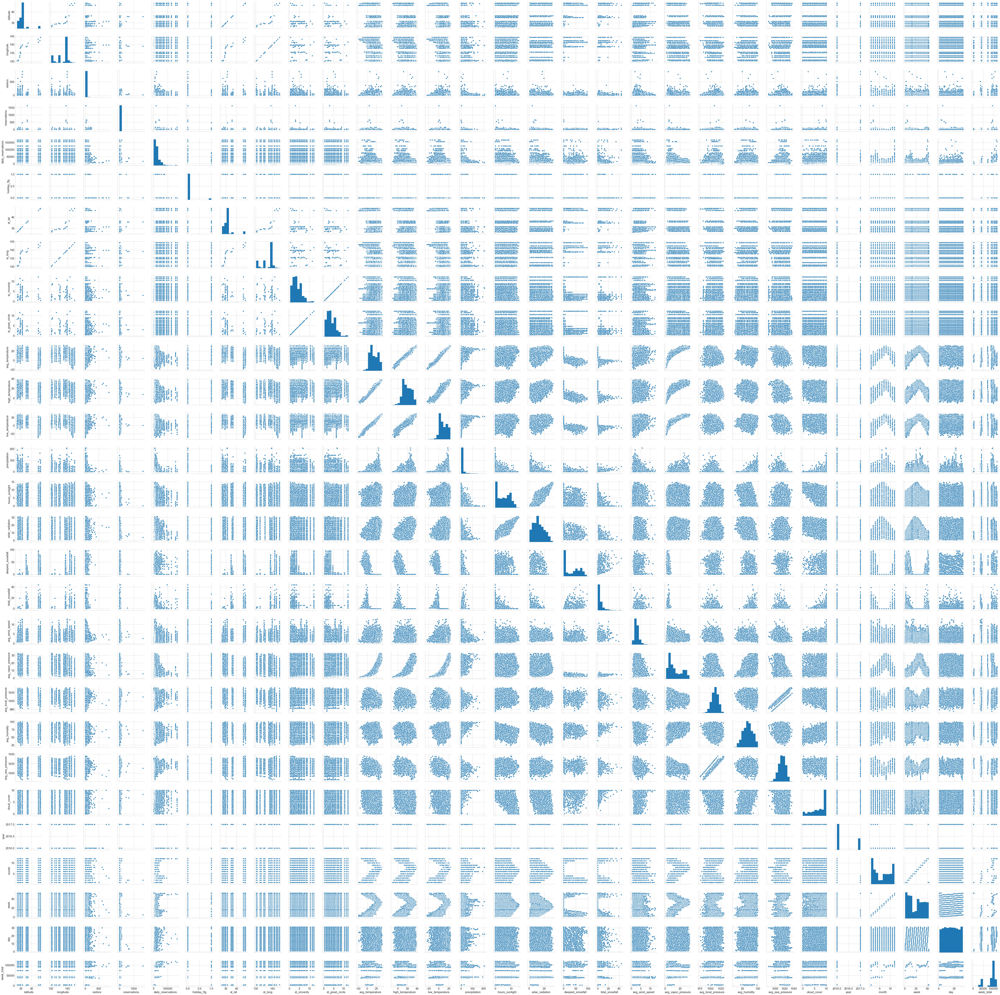

In [58]:
#plt.figure(figsize=(30,30))
sns.pairplot(FF)

In [171]:
max(FF['visitors'])

877

In [ ]:
FF['visit_datetime'] =  pd.to_datetime(FF['visit_datetime'], format = '%Y-%m-%d %H:%M:%S')
RS['reserve_datetime'] =  pd.to_datetime(RS['reserve_datetime'], format = '%Y-%m-%d %H:%M:%S')
RS['res_to_vis'] = (RS['visit_datetime'] - RS['reserve_datetime']) * 1
RS['visit_date'] = RS['visit_datetime'].dt.date
RS['reserve_date'] = RS['reserve_datetime'].dt.date
RS['visit_time'] = RS['visit_datetime'].dt.time
RS['reserve_time'] = RS['reserve_datetime'].dt.time
RS['visit_dow'] = RS['visit_datetime'].dt.day_name()
RS['reserve_dow'] = RS['reserve_datetime'].dt.day_name()

## Read Reservations csv file

In [181]:
RS = pd.read_csv("D:\\EndProject\\ReservationsData.csv",header=0)
RS['visit_date'] =  pd.to_datetime(RS['visit_date'], format = '%Y-%m-%d %H:%M:%S')
RS['reserve_datetime'] =  pd.to_datetime(RS['reserve_datetime'], format = '%Y-%m-%d %H:%M:%S')
RS['res_to_vis'] = (RS['visit_datetime'] - RS['reserve_datetime']) * 1
RS['visit_date'] = RS['visit_datetime'].dt.date
RS['reserve_date'] = RS['reserve_datetime'].dt.date
RS['visit_time'] = RS['visit_datetime'].dt.time
RS['reserve_time'] = RS['reserve_datetime'].dt.time
RS['visit_dow'] = RS['visit_datetime'].dt.day_name()
RS['reserve_dow'] = RS['reserve_datetime'].dt.day_name()

In [182]:
RS.dtypes

store_id                     object
visit_datetime       datetime64[ns]
reserve_datetime     datetime64[ns]
reserve_visitors              int64
res_to_vis          timedelta64[ns]
visit_date                   object
reserve_date                 object
visit_time                   object
reserve_time                 object
visit_dow                    object
reserve_dow                  object
dtype: object

In [185]:
RS.head(20)

,store_id,visit_datetime,reserve_datetime,reserve_visitors,res_to_vis,visit_date,reserve_date,visit_time,reserve_time,visit_dow,reserve_dow
0,ir_877f79706adbfb06,2016-01-01 19:00:00,2016-01-01 16:00:00,1,0 days 03:00:00,2016-01-01,2016-01-01,19:00:00,16:00:00,Friday,Friday
1,ir_db4b38ebe7a7ceff,2016-01-01 19:00:00,2016-01-01 19:00:00,3,0 days 00:00:00,2016-01-01,2016-01-01,19:00:00,19:00:00,Friday,Friday
2,ir_db4b38ebe7a7ceff,2016-01-01 19:00:00,2016-01-01 19:00:00,6,0 days 00:00:00,2016-01-01,2016-01-01,19:00:00,19:00:00,Friday,Friday
3,ir_877f79706adbfb06,2016-01-01 20:00:00,2016-01-01 16:00:00,2,0 days 04:00:00,2016-01-01,2016-01-01,20:00:00,16:00:00,Friday,Friday
4,ir_db80363d35f10926,2016-01-01 20:00:00,2016-01-01 01:00:00,5,0 days 19:00:00,2016-01-01,2016-01-01,20:00:00,01:00:00,Friday,Friday
5,ir_db80363d35f10926,2016-01-02 01:00:00,2016-01-01 16:00:00,2,0 days 09:00:00,2016-01-02,2016-01-01,01:00:00,16:00:00,Saturday,Friday
6,ir_db80363d35f10926,2016-01-02 01:00:00,2016-01-01 15:00:00,4,0 days 10:00:00,2016-01-02,2016-01-01,01:00:00,15:00:00,Saturday,Friday
7,ir_3bb99a1fe0583897,2016-01-02 16:00:00,2016-01-02 14:00:00,2,0 days 02:00:00,2016-01-02,2016-01-02,16:00:00,14:00:00,Saturday,Saturday
8,ir_3bb99a1fe0583897,2016-01-02 16:00:00,2016-01-01 20:00:00,2,0 days 20:00:00,2016-01-02,2016-01-01,16:00:00,20:00:00,Saturday,Friday
9,ir_2b8b29ddfd35018e,2016-01-02 17:00:00,2016-01-02 17:00:00,2,0 days 00:00:00,2016-01-02,2016-01-02,17:00:00,17:00:00,Saturday,Saturday


TypeError: unsupported operand type(s) for +: 'datetime.time' and 'datetime.time'

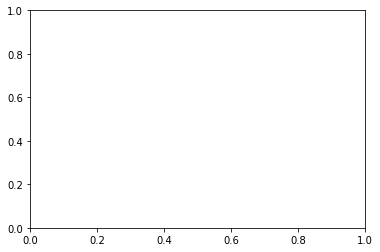

In [146]:
sns.distplot(RS['visit_time'])

In [152]:
#res_time = RS.groupby(['visit_time'])['reserve_visitors'].sum()
res_time

#sns.distplot(res_time)

visit_time
00:00:00      15201
01:00:00      10303
02:00:00       4166
03:00:00       1729
04:00:00       1289
05:00:00       5359
06:00:00      15045
07:00:00      11118
08:00:00       3208
09:00:00       2381
10:00:00       6790
11:00:00     198027
12:00:00     287329
13:00:00     131784
14:00:00      41390
15:00:00      35619
16:00:00      76561
17:00:00     767992
18:00:00    3567374
19:00:00    3855981
20:00:00    1000080
21:00:00     389282
22:00:00     104270
23:00:00      30930
Name: reserve_visitors, dtype: int64

### Need to analyze the reservations data first in order to add it to the FlatFile correctly , because they are not in the same structure.

In [143]:
res_dt = RS.groupby(['visit_time'])['store_id'].sum()
res_dt

store_id
ir_00a91d42b08b08d9    [ir_00a91d42b08b08d9]
ir_0164b9927d20bcc3    [ir_0164b9927d20bcc3]
ir_034a3d5b40d5b1b1    [ir_034a3d5b40d5b1b1]
ir_03963426c9312048    [ir_03963426c9312048]
ir_04341b588bde96cd    [ir_04341b588bde96cd]
ir_04cae7c1bc9b2a0b    [ir_04cae7c1bc9b2a0b]
ir_066f0221b8a4d533    [ir_066f0221b8a4d533]
ir_06f95ac5c33aca10    [ir_06f95ac5c33aca10]
ir_082908692355165e    [ir_082908692355165e]
ir_084d98859256acf0    [ir_084d98859256acf0]
ir_0867f7bebad6a649    [ir_0867f7bebad6a649]
ir_08cb3c4ee6cd6a22    [ir_08cb3c4ee6cd6a22]
ir_08ef81d5b7a0d13f    [ir_08ef81d5b7a0d13f]
ir_0a74a5408a0b8642    [ir_0a74a5408a0b8642]
ir_0b184ec04c741a6a    [ir_0b184ec04c741a6a]
ir_0b1e72d2d4422b20    [ir_0b1e72d2d4422b20]
ir_0e1eae99b8723bc1    [ir_0e1eae99b8723bc1]
ir_0f0cdeee6c9bf3d7    [ir_0f0cdeee6c9bf3d7]
ir_1033310359ceeac1    [ir_1033310359ceeac1]
ir_10bbe8acd943d8f6    [ir_10bbe8acd943d8f6]
ir_12c4fb7a423df20d    [ir_12c4fb7a423df20d]
ir_138ff410757b845f    [ir_138ff410757b845f]
i

TypeError: unsupported operand type(s) for +: 'datetime.date' and 'datetime.date'

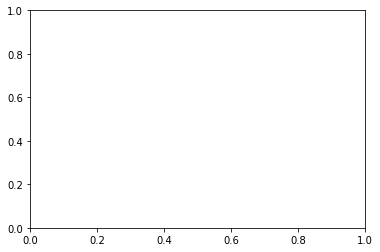

In [134]:
sns.distplot(RS['visit_date'])

In [92]:
#FF = FF[Vnames]
#FF.head()

### make a distinct locations list

In [93]:
UL = FF[['latitude', 'longitude']]
UL['location'] = UL['latitude'].astype(str) + ' ' +  UL['longitude'].astype(str)

c:\users\rnonk\appdata\local\programs\python\python35\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [94]:
UL = UL.drop_duplicates('location')

In [95]:
UL

,latitude,longitude,location
0,35.735623,139.651658,35.7356234 139.6516577
1,33.589216,130.392813,33.589215700000004 130.3928134
2,38.269076,140.870403,38.2690761 140.87040290000002
3,33.319286,130.508374,33.3192865 130.5083735
4,34.766093,135.628100,34.766092900000004 135.6280998
5,35.693840,139.703549,35.6938401 139.70354939999999
6,35.661777,139.704051,35.6617773 139.70405060000002
7,33.575686,130.369976,33.575686299999994 130.36997639999998
8,34.695124,135.197852,34.6951242 135.19785249999998
9,35.694003,139.753595,35.6940027 139.75359509999998


## Find region by location

In [85]:
y = 0
while y < len(UL):
    address, (latitude, longitude) = geolocator.reverse(UL['latitude'][y], UL['longitude'][y])
    print(address, latitude, longitude)
    y = y +1

GeocoderQueryError: Your request was denied.

In [ ]:
# Convert longitude and latitude to a location
results = Geocoder.reverse_geocode(FF['latitude'][0], FF['longitude'][0])

In [ ]:
# Print the city
results.city

In [ ]:
# Print the country
results.country

In [ ]:
# Print the admin1 level
results.administrative_area_level_1

## Adding reservations csv, reservations data in different structure

In [257]:
RS = pd.read_csv("D:\\EndProject\\ReservationsData.csv",header=0)

In [258]:
RS['visit_datetime'] =  pd.to_datetime(RS['visit_datetime'], format = '%Y-%m-%d %H:%M:%S')
RS['reserve_datetime'] =  pd.to_datetime(RS['reserve_datetime'], format = '%Y-%m-%d %H:%M:%S')
RS['res_to_vis'] = (RS['visit_datetime'] - RS['reserve_datetime']) * 1
RS['visit_date'] = RS['visit_datetime'].dt.date
RS['reserve_date'] = RS['reserve_datetime'].dt.date
RS['visit_time'] = RS['visit_datetime'].dt.time
RS['reserve_time'] = RS['reserve_datetime'].dt.time

In [271]:
print(RS.dtypes)
RS.head()

store_id                     object
visit_datetime       datetime64[ns]
reserve_datetime     datetime64[ns]
reserve_visitors              int64
res_to_vis          timedelta64[ns]
visit_date                   object
reserve_date                 object
visit_time                   object
reserve_time                 object
dtype: object


,store_id,visit_datetime,reserve_datetime,reserve_visitors,res_to_vis,visit_date,reserve_date,visit_time,reserve_time
0,ir_877f79706adbfb06,2016-01-01 19:00:00,2016-01-01 16:00:00,1,03:00:00,2016-01-01,2016-01-01,19:00:00,16:00:00
1,ir_db4b38ebe7a7ceff,2016-01-01 19:00:00,2016-01-01 19:00:00,3,00:00:00,2016-01-01,2016-01-01,19:00:00,19:00:00
2,ir_db4b38ebe7a7ceff,2016-01-01 19:00:00,2016-01-01 19:00:00,6,00:00:00,2016-01-01,2016-01-01,19:00:00,19:00:00
3,ir_877f79706adbfb06,2016-01-01 20:00:00,2016-01-01 16:00:00,2,04:00:00,2016-01-01,2016-01-01,20:00:00,16:00:00
4,ir_db80363d35f10926,2016-01-01 20:00:00,2016-01-01 01:00:00,5,19:00:00,2016-01-01,2016-01-01,20:00:00,01:00:00


In [279]:
vis_res_time = RS.groupby([RS['visit_time']])['reserve_visitors'].sum().reset_index(name='reserve_visitors').sort_values('visit_time')
#vis_res_time

In [280]:
res_res_time = RS.groupby([RS['reserve_time']])['reserve_visitors'].sum().reset_index(name='reserve_visitors').sort_values('reserve_time')
#res_res_time

In [ ]:
RS.groupby([RS['year_week']])['visitors'].sum().reset_index(name='week_total').sort_values('year_week')
#FF = pd.merge(FF, FF.groupby([FF['year_week']])['visitors'].sum().reset_index(name='week_total').sort_values('year_week'),  how='left', left_on='year_week',right_on='year_week')